In [1]:
from IPython.display import display, HTML, clear_output

display(HTML(data="""
<style>
    div#notebook-container    { width: 90%; }
    div#menubar-container     { width: 90%; }
    div#maintoolbar-container { width: 90%; }
</style>
"""))

import pandas as pd
import numpy as np
import os
import glob
import sys
import datetime
import json
from pandas.io.json import json_normalize

from datetime import timedelta
from pathlib import Path
import time
import seaborn as sns
import matplotlib
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pyreadstat

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import warnings
warnings. filterwarnings('ignore')

pd.options.display.html.table_schema = True
pd.set_option('display.max_columns', 500)

#alt.renderers.enable('notebook')

In [2]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score, roc_auc_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, OneHotEncoder
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge, Lasso, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import export_graphviz
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsClassifier

In [3]:
import folium
from folium import plugins

print(folium.__version__)

0.12.1.post1


In [4]:
# Load data
df = pd.read_csv(r'C:\Users\croth\Documents\Northwestern University\MSDS 498\MSDS 498 - Capstone Group Project\Data\EDA_2024012\5_years_merged_with_weather_and_311and_policedistance.csv')

df.columns = df.columns.str.lower()

df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance
0,13211437,JG425074,2019-01-01 00:00:00,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,NaN,NaN,NaN,NaN,NaN,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [5]:
output = r"C:\Users\croth\Documents\Northwestern University\MSDS 498\Exploratory Data Analysis\output_2023"

In [6]:
df['date'] = pd.to_datetime(df['date'])

df['dow'] = df.date.dt.weekday
df[['dow']] = df[['dow']].replace([0,1,2,3,4,5,6], ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

df.loc[((df.dow == 'Monday') | (df.dow == 'Tuesday') | (df.dow == 'Wednesday') | (df.dow == 'Thursday') | (df.dow == 'Friday')), 'daytype'] = 'Weekday'
df.loc[((df.dow == 'Saturday') | (df.dow == 'Sunday')), 'daytype'] = 'Weekend'

In [7]:
monthOrder = ['January','February','March','April','May','June','July','August','September','October','November','December']
dayOrder = ['Sunday', 'Monday','Tuesday','Wednesday','Thursday','Friday','Saturday']

In [8]:
df['date'] = df['date'].dt.strftime('%Y-%m-%d')

In [9]:
df['date'].unique()

array(['2019-01-01', '2019-01-02', '2019-01-03', ..., '2023-12-29',
       '2023-12-30', '2023-12-31'], dtype=object)

In [10]:
df['month_num'] = df.date.str[5:7]
df['year'] = df.date.str[:4]

In [11]:
months = {'01' : 'January', '02' : 'February', '03' : 'March',
           '04' : 'April', '05' : 'May', '06' : 'June',
           '07' : 'July', '08' : 'August', '09' : 'September',
           '10' : 'October',   '11' : 'November',   '12' : 'December'}
df['month'] = df['month_num'].map(months)
df.sample(5)

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month
29868,11599144,JC156565,2019-02-15,0000X N MICHIGAN AVE,0820,THEFT,$500 AND UNDER,PARKING LOT/GARAGE(NON.RESID.),False,False,114,1,42.0,32.0,06,2019,2019-02-22T16:04:55.000,41.882526,-87.624384,41.882526,-87.624384,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",11.0,316.0,0.0,0.0,33.08,10.94,19.22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [12]:
# df = df[df.year == '2023']
# df

#### Map Community Areas based on their Regions

In [13]:
with open(r'C:\Users\croth\Documents\Northwestern University\MSDS 498\Exploratory Data Analysis\Boundaries - Community Areas (current).geojson') as f:
    data=json.load(f)

df_comm_area = pd.json_normalize(data, record_path=['features'])

In [14]:
df_comm_area

,type,properties.community,properties.area,properties.shape_area,properties.perimeter,properties.area_num_1,properties.area_numbe,properties.comarea_id,properties.comarea,properties.shape_len,geometry.type,geometry.coordinates
0,Feature,DOUGLAS,0,46004621.1581,0,35,35,0,0,31027.0545098,MultiPolygon,"[[[[-87.60914087617894, 41.84469250265398], [-..."
1,Feature,OAKLAND,0,16913961.0408,0,36,36,0,0,19565.5061533,MultiPolygon,"[[[[-87.59215283879394, 41.81692934626684], [-..."
2,Feature,FULLER PARK,0,19916704.8692,0,37,37,0,0,25339.0897503,MultiPolygon,"[[[[-87.62879823733725, 41.80189303368919], [-..."
3,Feature,GRAND BOULEVARD,0,48492503.1554,0,38,38,0,0,28196.8371573,MultiPolygon,"[[[[-87.6067081256125, 41.81681377057218], [-8..."
4,Feature,KENWOOD,0,29071741.9283,0,39,39,0,0,23325.1679062,MultiPolygon,"[[[[-87.59215283879394, 41.81692934626684], [-..."
...,...,...,...,...,...,...,...,...,...,...,...,...
72,Feature,MOUNT GREENWOOD,0,75584290.0209,0,74,74,0,0,48665.1305392,MultiPolygon,"[[[[-87.69645961375822, 41.70714491233857], [-..."
73,Feature,MORGAN PARK,0,91877340.6988,0,75,75,0,0,46396.419362,MultiPolygon,"[[[[-87.64215204651398, 41.685082119670845], [..."
74,Feature,OHARE,0,371835607.687,0,76,76,0,0,173625.98466,MultiPolygon,"[[[[-87.83658087874365, 41.986396111591276], [..."
75,Feature,EDGEWATER,0,48449990.8397,0,77,77,0,0,31004.8309456,MultiPolygon,"[[[[-87.65455590025104, 41.99816614970252], [-..."


In [15]:
df_comm_area_filter = df_comm_area[['properties.community','properties.area_numbe']]

df_comm_area_filter = df_comm_area_filter.rename(columns={'properties.community':'community_name',
                                                          'properties.area_numbe':'community_area'})

df_comm_area_filter.to_csv(output + '\df_comm_area_filter.csv')

df_comm_area_filter

,community_name,community_area
0,DOUGLAS,35
1,OAKLAND,36
2,FULLER PARK,37
3,GRAND BOULEVARD,38
4,KENWOOD,39
...,...,...
72,MOUNT GREENWOOD,74
73,MORGAN PARK,75
74,OHARE,76
75,EDGEWATER,77


In [16]:
df_comm_mapped = pd.read_excel(r'C:\Users\croth\Documents\Northwestern University\MSDS 498\Exploratory Data Analysis\input\df_comm_area_filter.xlsx')

df_comm_mapped.columns = df_comm_mapped.columns.str.lower()

df_comm_mapped

,community_name,community_area,regional_community
0,ALBANY PARK,14,Far North Side
1,ARCHER HEIGHTS,57,Southwest Side
2,ARMOUR SQUARE,34,South Side
3,ASHBURN,70,Far Southwest Side
4,AUBURN GRESHAM,71,Far Southwest Side
...,...,...,...
72,WEST LAWN,65,Southwest Side
73,WEST PULLMAN,53,Far Southeast Side
74,WEST RIDGE,2,Far North Side
75,WEST TOWN,24,West Side


In [17]:
df = pd.merge(df,df_comm_mapped, on='community_area', how='left')

In [18]:
df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community
0,13211437,JG425074,2019-01-01,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,NaN,NaN,NaN,NaN,NaN,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

#### Merge 2020 Chicago Population by Community Area

In [19]:
df_population = pd.read_excel(r'C:\Users\croth\Documents\Northwestern University\MSDS 498\MSDS 498 - Capstone Group Project\Data\2020PopulationbyCommunity.xlsx')

df_population.columns = df_population.columns.str.lower()

df_population = df_population.rename(columns={'community no.':'community_area'})

df_population

,community_area,name,population,area(sq mi.),density (/sq mi.)
0,1,Rogers Park,55628,1.84,30232.61
1,2,West Ridge,77122,3.53,21847.59
2,3,Uptown,57182,2.32,24647.41
3,4,Lincoln Square,40494,2.56,15817.97
4,5,North Center,35114,2.05,17128.78
...,...,...,...,...,...
72,73,Washington Heights,25065,2.86,8763.99
73,74,Mount Greenwood,18628,2.71,6873.80
74,75,Morgan Park,21186,3.30,6420.00
75,76,O'Hare,13418,13.34,1005.85


In [20]:
df = pd.merge(df,df_population, on='community_area', how='left')
df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.)
0,13211437,JG425074,2019-01-01,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,NaN,NaN,NaN,NaN,NaN,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [21]:
df_test = df[['name','population','area(sq mi.)','density (/sq mi.)']]

df_test.isnull().sum()

name                 2
population           2
area(sq mi.)         2
density (/sq mi.)    2
dtype: int64

In [22]:
df[df.name.isna()]

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.)
389429,12130807,JD326684,2020-08-09,052XX S JUSTINE ST,041A,BATTERY,AGGRAVATED - HANDGUN,ALLEY,False,False,934,9,8.0,NaN,04B,2020,2020-11-04T15:42:11.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,89.96,71.96,80.96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

#### Map Type of Crime Based on Category

In [23]:
type_of_crime = {'CRIMINAL SEXUAL ASSAULT' : 'violent_crime', 
                'OFFENSE INVOLVING CHILDREN' : 'violent_crime', 
                'THEFT' : 'property_crime',
                'DECEPTIVE PRACTICE' : 'violent_crime', 
                'OTHER OFFENSE' : 'nonviolent_crime', 
                'BURGLARY' : 'property_crime',
                'CRIMINAL DAMAGE' : 'property_crime', 
                'CRIMINAL TRESPASS' : 'nonviolent_crime', 
                'WEAPONS VIOLATION' : 'nonviolent_crime',
                'BATTERY' : 'violent_crime', 
                'STALKING' : 'nonviolent_crime', 
                'ASSAULT' : 'violent_crime', 
                'SEX OFFENSE' : 'violent_crime',
                'MOTOR VEHICLE THEFT' : 'property_crime', 
                'OBSCENITY' : 'nonviolent_crime', 
                'PUBLIC PEACE VIOLATION' : 'nonviolent_crime',
                'LIQUOR LAW VIOLATION' : 'nonviolent_crime', 
                'ROBBERY' : 'violent_crime', 
                'HOMICIDE' : 'violent_crime', 
                'NARCOTICS' : 'nonviolent_crime',
                'ARSON' : 'property_crime', 
                'CONCEALED CARRY LICENSE VIOLATION' : 'nonviolent_crime',
                'INTERFERENCE WITH PUBLIC OFFICER' : 'nonviolent_crime', 
                'KIDNAPPING' : 'violent_crime', 
                'INTIMIDATION' : 'nonviolent_crime',
                'PROSTITUTION' : 'nonviolent_crime', 
                'GAMBLING' : 'nonviolent_crime',
                'CRIM SEXUAL ASSAULT' : 'violent_crime',
                'HUMAN TRAFFICKING' : 'violent_crime', 
                'NON-CRIMINAL' : 'nonviolent_crime', 
                'OTHER NARCOTIC VIOLATION' : 'nonviolent_crime', 
                'PUBLIC INDECENCY' : 'nonviolent_crime',
                'RITUALISM' : 'violent_crime'}

df['crime_category'] = df['primary_type'].map(type_of_crime)

df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.),crime_category
0,13211437,JG425074,2019-01-01,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,NaN,NaN,NaN,NaN,NaN,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [24]:
df.shape

(1181139, 147)

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1181139 entries, 0 to 1181138
Columns: 147 entries, id to crime_category
dtypes: bool(2), float64(122), int64(3), object(20)
memory usage: 1.3+ GB


In [26]:
df.primary_type.nunique()

33

In [27]:
df.closest_station.value_counts()

4650 N Pulaski Rd            126155
3510 S Michigan Ave           91850
2255 E 103rd St               86124
6464 N Clark St               66840
5400 N Lincoln Ave            64612
5101 S Wentworth Ave          63675
5555 W Grand Ave              62736
5701 W Madison St             59033
3315 W Ogden Ave              54965
7040 S Cottage Grove Ave      54771
1412 S Blue Island Ave\n      48172
1438 W 63rd St                44980
1718 S State St               43696
727 E 111th St                40676
2150 N California Ave         38913
7808 S Halsted St             37980
1900 W Monterey Ave           35332
1160 N Larrabee St            34239
3151 W Harrison St            34134
850 W Addison St              32129
3120 S Halsted St             24341
Error something something     17011
3420 W 63rd St                14446
5151 N Milwaukee Ave           4329
Name: closest_station, dtype: int64

In [28]:
df.closest_station.nunique()

24

#### Data Cleansing - Handling Null Values

In [29]:
df_test = df[['prcp','snow','tempmax_f','tempmin_f','tempavg_f']]

df_test.isnull().sum()

prcp         0
snow         0
tempmax_f    0
tempmin_f    0
tempavg_f    0
dtype: int64

In [30]:
df_test = df[['name','population','area(sq mi.)','density (/sq mi.)']]

df_test.isnull().sum()

name                 2
population           2
area(sq mi.)         2
density (/sq mi.)    2
dtype: int64

In [31]:
df.isnull().sum()

id                   0
case_number          0
date                 0
block                0
iucr                 0
                    ..
name                 2
population           2
area(sq mi.)         2
density (/sq mi.)    2
crime_category       0
Length: 147, dtype: int64

In [32]:
pd.isnull(df).sum()[pd.isnull(df).sum() > 0]

location_description     6241
ward                       48
community_area              2
latitude                17007
longitude               17007
                        ...  
regional_community          2
name                        2
population                  2
area(sq mi.)                2
density (/sq mi.)           2
Length: 121, dtype: int64

In [33]:
df.columns[df.isnull().any()].tolist()

['location_description',
 'ward',
 'community_area',
 'latitude',
 'longitude',
 'location.latitude',
 'location.longitude',
 'location.human_address',
 'total_offenders_in_ca',
 'total_complaints_in_ca',
 'abandoned vehicle complaint',
 'aircraft noise complaint',
 'alley light out complaint',
 'alley pothole complaint',
 'alley sewer inspection request',
 'animal in trap complaint',
 'bee/wasp removal',
 'bicycle request/complaint',
 'blue recycling cart',
 'building violation',
 'buildings - plumbing violation',
 'bungalow/vintage home information request',
 'business complaints',
 'cab feedback',
 'cable tv complaint',
 'check for leak',
 'city vehicle sticker violation',
 'clean vacant lot request',
 'clean and green program request',
 'commercial fire safety inspection request',
 'consumer fraud complaint',
 'consumer retail business complaint',
 'coyote interaction complaint',
 'dead animal pick-up request',
 'dead bird',
 'divvy bike parking complaint',
 'e-scooter',
 'e-scoote

In [34]:
nullvalues = pd.DataFrame(df.isnull().sum().sort_values(ascending=False)).reset_index().T

nullvalues = nullvalues.rename(columns={0:'num_missing_values'})

#nullvalues.to_csv(output + '\test.csv')

nullvalues

,num_missing_values,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146
index,longitude,location.longitude,location.human_address,latitude,location.latitude,total_offenders_in_ca,location_description,rodent baiting/rat complaint,ridesharing complaint,restaurant complaint,report an injured animal,sanitation code violation,recycling pick up,recycling inspection request,pushcart food vendor complaint,public vehicle/valet complaint,protected bike lane - debris removal,sewer cave-in inspection request,sewer cleaning inspection request,renters and foreclosure complaint,no water complaint,sidewalk café/outdoor dining complaint,pothole in street complaint,porch inspection request,petcoke dust complaint,pet wellness check request,pavement cave-in inspection request,paid sick leave violation,outdated merchandise complaint,open fire hydrant complaint,nuisance animal complaint,water on street complaint,no solicitation complaint,no building permit and construction violation,missed garbage pick-up complaint,low water pressure complaint,shared housing/vacation rental complaint,sign repair request - one way sign,sidewalk inspection request,tobacco - general complaint,wage complaint,vicious animal complaint,viaduct light out complaint,vehicle parked in bike lane complaint,vacant/abandoned building complaint,tree trim request (no longer being accepted),tree removal request,tree planting request,tree emergency,tree debris clean-up request,traffic signal out complaint,tobacco - sale to minors complaint,street light pole door missing complaint,sign repair request - all other signs,street light pole damage complaint,street light out complaint,street light on during day complaint,street cleaning request,stray animal complaint,snow – uncleared sidewalk complaint,snow removal - protected bike lane or bridge s...,snow - object/dibs removal request,smokeless tobacco at sports event complaint,sign repair request - stop sign,licensed pharmaceutical representative complaint,sign repair request - do not enter sign,liquor establishment complaint,inaccurate fuel pump complaint,lead inspection request,check for leak,cab feedback,business complaints,bungalow/vintage home information request,buildings - plumbing violation,building violation,inspect public way request,bicycle request/complaint,bee/wasp removal,animal in trap complaint,alley sewer inspection request,alley pothole complaint,alley light out complaint,aircraft noise complaint,abandoned vehicle complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,cable tv complaint,blue recycling cart,city vehicle sticker violation,e-scooter parking complaint,inaccurate retail scales complaint,clean vacant lot request,ice and snow removal request,home buyer program info request,graffiti removal request,garbage cart maintenance,fly dumping complaint,extreme weather notification,water lead test visit request,e-scooter,consumer fraud complaint,divvy bike parking complaint,clean and green program request,commercial fire safety inspection request,water lead test kit request,consumer retail business complaint,dead animal pick-up request,dead bird,coyote interaction complaint,ward,regional_community,total_complaints_in_ca,density (/sq mi.),area(sq mi.),community_area,population,name,community_name,daytype,month,month_num,closest_station_distance,closest_station,dow,id,case_number,beat,date,block,iucr,primary_type,description,arrest,domestic,district,tempavg_f,fbi_code,year,updated_on,prcp,snow,tempmax_f,tempmin_f,crime_category
0,17007

In [35]:
df_test = df[['community_area', 'total_offenders_in_ca','total_complaints_in_ca']]

df_test.isnull().sum()

community_area                2
total_offenders_in_ca     16723
total_complaints_in_ca        2
dtype: int64

In [36]:
df_test.groupby('community_area').agg(tot_offenders=('total_offenders_in_ca','mean')).sort_values(by = 'tot_offenders', ascending=False)

,tot_offenders
community_area,
69.0,127.0
44.0,109.0
49.0,106.0
68.0,99.0
67.0,90.0
...,...
13.0,3.0
52.0,2.0
47.0,2.0


In [37]:
df['total_offenders_in_ca'] = df['total_offenders_in_ca'].fillna(0)

df['community_area'] = df['community_area'].fillna(-99)
df['total_complaints_in_ca'] = df['total_complaints_in_ca'].fillna(-99)

In [38]:
df_test = df[['community_area', 'total_offenders_in_ca','total_complaints_in_ca']]

df_test.isnull().sum()

community_area            0
total_offenders_in_ca     0
total_complaints_in_ca    0
dtype: int64

In [39]:
df_test.groupby('community_area').agg(tot_offenders=('total_offenders_in_ca','mean')).sort_values(by = 'tot_offenders', ascending=False)

,tot_offenders
community_area,
69.0,127.0
44.0,109.0
49.0,106.0
68.0,99.0
67.0,90.0
...,...
52.0,2.0
47.0,2.0
36.0,0.0


In [40]:
pd.isnull(df).sum()[pd.isnull(df).sum() > 0]

location_description     6241
ward                       48
latitude                17007
longitude               17007
location.latitude       17007
                        ...  
regional_community          2
name                        2
population                  2
area(sq mi.)                2
density (/sq mi.)           2
Length: 118, dtype: int64

In [41]:
df.columns[df.isnull().any()].tolist()

['location_description',
 'ward',
 'latitude',
 'longitude',
 'location.latitude',
 'location.longitude',
 'location.human_address',
 'abandoned vehicle complaint',
 'aircraft noise complaint',
 'alley light out complaint',
 'alley pothole complaint',
 'alley sewer inspection request',
 'animal in trap complaint',
 'bee/wasp removal',
 'bicycle request/complaint',
 'blue recycling cart',
 'building violation',
 'buildings - plumbing violation',
 'bungalow/vintage home information request',
 'business complaints',
 'cab feedback',
 'cable tv complaint',
 'check for leak',
 'city vehicle sticker violation',
 'clean vacant lot request',
 'clean and green program request',
 'commercial fire safety inspection request',
 'consumer fraud complaint',
 'consumer retail business complaint',
 'coyote interaction complaint',
 'dead animal pick-up request',
 'dead bird',
 'divvy bike parking complaint',
 'e-scooter',
 'e-scooter parking complaint',
 'extreme weather notification',
 'fly dumping com

In [42]:
df_test = df[['location_description',
'ward',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'community_name',
'regional_community',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)']]

df_test.isnull().sum()

location_description       6241
ward                         48
latitude                  17007
longitude                 17007
location.latitude         17007
location.longitude        17007
location.human_address    17007
community_name                2
regional_community            2
name                          2
population                    2
area(sq mi.)                  2
density (/sq mi.)             2
dtype: int64

In [43]:
df['location_description'] = df['location_description'].fillna(-99)
df['ward'] = df['ward'].fillna(-99)
df['latitude'] = df['latitude'].fillna(-99)
df['longitude'] = df['longitude'].fillna(-99)
df['location.latitude'] = df['location.latitude'].fillna(-99)
df['location.longitude'] = df['location.longitude'].fillna(-99)
df['location.human_address'] = df['location.human_address'].fillna(-99)

df['community_name'] = df['community_name'].fillna(-99)
df['regional_community'] = df['regional_community'].fillna(-99)
df['name'] = df['name'].fillna(-99)
df['population'] = df['population'].fillna(-99)
df['area(sq mi.)'] = df['area(sq mi.)'].fillna(-99)
df['density (/sq mi.)'] = df['density (/sq mi.)'].fillna(-99)

In [44]:
df_test = df[['location_description',
'ward',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'community_name',
'regional_community',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)']]

df_test.isnull().sum()

location_description      0
ward                      0
latitude                  0
longitude                 0
location.latitude         0
location.longitude        0
location.human_address    0
community_name            0
regional_community        0
name                      0
population                0
area(sq mi.)              0
density (/sq mi.)         0
dtype: int64

In [45]:
df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.),crime_category
0,13211437,JG425074,2019-01-01,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,-99.000000,-99.000000,-99.000000,-99.000000,-99,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [46]:
df.columns[df.isnull().any()].tolist()

['abandoned vehicle complaint',
 'aircraft noise complaint',
 'alley light out complaint',
 'alley pothole complaint',
 'alley sewer inspection request',
 'animal in trap complaint',
 'bee/wasp removal',
 'bicycle request/complaint',
 'blue recycling cart',
 'building violation',
 'buildings - plumbing violation',
 'bungalow/vintage home information request',
 'business complaints',
 'cab feedback',
 'cable tv complaint',
 'check for leak',
 'city vehicle sticker violation',
 'clean vacant lot request',
 'clean and green program request',
 'commercial fire safety inspection request',
 'consumer fraud complaint',
 'consumer retail business complaint',
 'coyote interaction complaint',
 'dead animal pick-up request',
 'dead bird',
 'divvy bike parking complaint',
 'e-scooter',
 'e-scooter parking complaint',
 'extreme weather notification',
 'fly dumping complaint',
 'garbage cart maintenance',
 'graffiti removal request',
 'home buyer program info request',
 'ice and snow removal request

In [47]:
df = df.fillna(0)

In [48]:
df.columns[df.isnull().any()].tolist()

[]

In [49]:
df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.),crime_category
0,13211437,JG425074,2019-01-01,009XX N HAMLIN AVE,1562,SEX OFFENSE,AGGRAVATED CRIMINAL SEXUAL ABUSE,RESIDENCE,False,False,1112,11,27.0,23.0,17,2019,2023-09-16T15:42:58.000,-99.000000,-99.000000,-99.000000,-99.000000,-99,59.0,151.0,0.0,0.0,35.96,26.96,30.74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [50]:
df.primary_type.unique()

array(['SEX OFFENSE', 'DECEPTIVE PRACTICE', 'CRIMINAL SEXUAL ASSAULT',
       'PROSTITUTION', 'OFFENSE INVOLVING CHILDREN', 'BATTERY', 'THEFT',
       'OTHER OFFENSE', 'CRIMINAL DAMAGE', 'CRIM SEXUAL ASSAULT',
       'MOTOR VEHICLE THEFT', 'ROBBERY', 'WEAPONS VIOLATION', 'BURGLARY',
       'ASSAULT', 'CRIMINAL TRESPASS', 'NARCOTICS',
       'PUBLIC PEACE VIOLATION', 'LIQUOR LAW VIOLATION',
       'INTERFERENCE WITH PUBLIC OFFICER', 'KIDNAPPING', 'INTIMIDATION',
       'STALKING', 'ARSON', 'CONCEALED CARRY LICENSE VIOLATION',
       'HOMICIDE', 'HUMAN TRAFFICKING', 'GAMBLING', 'OBSCENITY',
       'NON-CRIMINAL', 'OTHER NARCOTIC VIOLATION', 'PUBLIC INDECENCY',
       'RITUALISM'], dtype=object)

In [51]:
df.primary_type.value_counts()

THEFT                                256338
BATTERY                              216387
CRIMINAL DAMAGE                      133834
ASSAULT                              102514
DECEPTIVE PRACTICE                    87596
MOTOR VEHICLE THEFT                   80072
OTHER OFFENSE                         73375
ROBBERY                               43743
WEAPONS VIOLATION                     41099
BURGLARY                              40049
NARCOTICS                             37754
CRIMINAL TRESPASS                     23321
OFFENSE INVOLVING CHILDREN             9958
CRIMINAL SEXUAL ASSAULT                6570
SEX OFFENSE                            5970
PUBLIC PEACE VIOLATION                 4960
INTERFERENCE WITH PUBLIC OFFICER       3489
HOMICIDE                               3467
ARSON                                  2418
STALKING                               1749
PROSTITUTION                           1547
CRIM SEXUAL ASSAULT                     983
LIQUOR LAW VIOLATION            

In [52]:
replacements = {
    'primary_type' : {
        'CRIM SEXUAL ASSAULT':'CRIMINAL SEXUAL ASSAULT'}
}

df.replace(replacements, regex=True, inplace=True)

In [53]:
df.primary_type.value_counts()

THEFT                                256338
BATTERY                              216387
CRIMINAL DAMAGE                      133834
ASSAULT                              102514
DECEPTIVE PRACTICE                    87596
MOTOR VEHICLE THEFT                   80072
OTHER OFFENSE                         73375
ROBBERY                               43743
WEAPONS VIOLATION                     41099
BURGLARY                              40049
NARCOTICS                             37754
CRIMINAL TRESPASS                     23321
OFFENSE INVOLVING CHILDREN             9958
CRIMINAL SEXUAL ASSAULT                7553
SEX OFFENSE                            5970
PUBLIC PEACE VIOLATION                 4960
INTERFERENCE WITH PUBLIC OFFICER       3489
HOMICIDE                               3467
ARSON                                  2418
STALKING                               1749
PROSTITUTION                           1547
LIQUOR LAW VIOLATION                    941
CONCEALED CARRY LICENSE VIOLATIO

In [54]:
#df.to_csv(output + '\df_all_five_years.csv')

In [55]:
df = df[df.year == '2023']

df.to_csv(output + '\df_2023.csv')

df

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,abandoned vehicle complaint,aircraft noise complaint,alley light out complaint,alley pothole complaint,alley sewer inspection request,animal in trap complaint,bee/wasp removal,bicycle request/complaint,blue recycling cart,building violation,buildings - plumbing violation,bungalow/vintage home information request,business complaints,cab feedback,cable tv complaint,check for leak,city vehicle sticker violation,clean vacant lot request,clean and green program request,commercial fire safety inspection request,consumer fraud complaint,consumer retail business complaint,coyote interaction complaint,dead animal pick-up request,dead bird,divvy bike parking complaint,e-scooter,e-scooter parking complaint,extreme weather notification,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,ice and snow removal request,inaccurate fuel pump complaint,inaccurate retail scales complaint,inspect public way request,lead inspection request,licensed pharmaceutical representative complaint,liquor establishment complaint,low water pressure complaint,missed garbage pick-up complaint,no building permit and construction violation,no solicitation complaint,no water complaint,nuisance animal complaint,open fire hydrant complaint,outdated merchandise complaint,paid sick leave violation,pavement cave-in inspection request,pet wellness check request,petcoke dust complaint,porch inspection request,pothole in street complaint,protected bike lane - debris removal,public vehicle/valet complaint,pushcart food vendor complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,report an injured animal,restaurant complaint,ridesharing complaint,rodent baiting/rat complaint,sanitation code violation,sewer cave-in inspection request,sewer cleaning inspection request,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,smokeless tobacco at sports event complaint,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,tobacco - general complaint,tobacco - sale to minors complaint,traffic signal out complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),vacant/abandoned building complaint,vehicle parked in bike lane complaint,viaduct light out complaint,vicious animal complaint,wage complaint,water lead test kit request,water lead test visit request,water on street complaint,water quality concern,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,name,population,area(sq mi.),density (/sq mi.),crime_category
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

#### Create separate datasets for each of the Categorized Complaints

In [56]:
df_animal_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',                                                
'animal in trap complaint',
'bee/wasp removal',
'coyote interaction complaint',
'dead animal pick-up request',
'dead bird',
'nuisance animal complaint',
'pet wellness check request',
'report an injured animal',
'rodent baiting/rat complaint',
'vicious animal complaint']]

df_animal_complaint['tot_num_animal_complaints'] = df_animal_complaint['animal in trap complaint'] + df_animal_complaint['bee/wasp removal'] + df_animal_complaint['coyote interaction complaint'] + df_animal_complaint['dead animal pick-up request'] + df_animal_complaint['dead bird'] + df_animal_complaint['nuisance animal complaint'] + df_animal_complaint['pet wellness check request'] + df_animal_complaint['report an injured animal'] + df_animal_complaint['rodent baiting/rat complaint'] + df_animal_complaint['vicious animal complaint']

df_animal_complaint.to_csv(output + '\df_2023_animal_complaint.csv')

df_animal_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),animal in trap complaint,bee/wasp removal,coyote interaction complaint,dead animal pick-up request,dead bird,nuisance animal complaint,pet wellness check request,report an injured animal,rodent baiting/rat complaint,vicious animal complaint,tot_num_animal_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183.0,3.8,0.0,44.96,37.04,41.72,850 W Addison St,0.256114,Sunday,Weekend,01,January,EDGEWATER,Far North Side,property_crime,Edgewater,56296.0,1.74,32354.02,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,4.0
921840,13223672,JG439926,2023-01-01,003XX N MAY ST,1140,DECEPTIVE PRACTICE,EMBEZZLEMENT,APARTMENT,False,False,1214,12,27.0,28.0,12,2023,2023-09-28T15:41:33.000,41.887136,-87.655685,41.887136,-87.655685,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",12.0,328.0,3.8,0.0,44.96,37.04,41.72,1412 S Blue Island Ave\n,0.112622,Sunday,Weekend,01,January,NEAR WEST SIDE,West Side,violent_crime,Near West Side,67881.0,5.69,11929.88,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181134,13330925,JH106755,2023-12-31,004XX E 40TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,214,2,3.0,38.0,08B,2023,2024-01-08T15:59:16.000,41.821173,-87.615042,41.821173,-87.615042,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",11.0,92.0,1.1,0.0,37.94,32.00,34.34,3510 S Michigan Ave,0.580390,Sunday,Weekend,12,December,GRAND BOULEVARD,South Side,violent_crime,Grand Boulevard,24589.0,1.74,14131.61,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1181135,13330361,JH106334,2023-12-31,046XX W MONROE ST,1585,SEX OFFENSE,OTHER,RE

In [57]:
df_business_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'building violation',
'buildings - plumbing violation',
'business complaints',
'consumer fraud complaint',
'consumer retail business complaint',
'inaccurate fuel pump complaint',
'inaccurate retail scales complaint',
'licensed pharmaceutical representative complaint',
'no building permit and construction violation',
'outdated merchandise complaint',
'paid sick leave violation',
'pushcart food vendor complaint',
'restaurant complaint',
'sanitation code violation',
'shared housing/vacation rental complaint',
'sidewalk café/outdoor dining complaint',
'wage complaint']]

df_business_complaint['tot_num_business_complaints'] = df_business_complaint['building violation'] + df_business_complaint['buildings - plumbing violation'] + df_business_complaint['business complaints'] + df_business_complaint['consumer fraud complaint'] + df_business_complaint['consumer retail business complaint'] + df_business_complaint['inaccurate fuel pump complaint'] + df_business_complaint['inaccurate retail scales complaint'] + df_business_complaint['licensed pharmaceutical representative complaint'] + df_business_complaint['no building permit and construction violation'] + df_business_complaint['outdated merchandise complaint'] + df_business_complaint['paid sick leave violation'] + df_business_complaint['pushcart food vendor complaint'] + df_business_complaint['restaurant complaint'] + df_business_complaint['sanitation code violation'] + df_business_complaint['shared housing/vacation rental complaint'] + df_business_complaint['sidewalk café/outdoor dining complaint'] + df_business_complaint['wage complaint']

df_business_complaint.to_csv(output + '\df_2023_business_complaint.csv')

df_business_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),building violation,buildings - plumbing violation,business complaints,consumer fraud complaint,consumer retail business complaint,inaccurate fuel pump complaint,inaccurate retail scales complaint,licensed pharmaceutical representative complaint,no building permit and construction violation,outdated merchandise complaint,paid sick leave violation,pushcart food vendor complaint,restaurant complaint,sanitation code violation,shared housing/vacation rental complaint,sidewalk café/outdoor dining complaint,wage complaint,tot_num_business_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183.0,3.8,0.0,44.96,37.04,41.72,850 W Addison St,0.256114,Sunday,Weekend,01,January,EDGEWATER,Far North Side,property_crime,Edgewater,56296.0,1.74,32354.02,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
921840,13223672,JG439926,2023-01-01,003XX N MAY ST,1140,DECEPTIVE PRACTICE,EMBEZZLEMENT,APARTMENT,False,False,1214,12,27.0,28.0,12,2023,2023-09-28T15:41:33.000,41.887136,-87.655685,41.887136,-87.655685,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",12.0,328.0,3.8,0.0,44.96,37.04,41.72,1412 S Blue Island Ave\n,0.112622,Sunday,Weekend,01,January,NEAR WEST SIDE,West Side,violent_crime,Near West Side,67881.0,5.69,11929.88,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181134,13330925,JH106755,2023-12-31,004XX E 40TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,2

In [58]:
df_drugs_alcohol_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'liquor establishment complaint',
'smokeless tobacco at sports event complaint',
'tobacco - general complaint',
'tobacco - sale to minors complaint']]

df_drugs_alcohol_complaint['tot_num_drugs_alcohol_complaints'] = df_drugs_alcohol_complaint['liquor establishment complaint'] + df_drugs_alcohol_complaint['smokeless tobacco at sports event complaint'] + df_drugs_alcohol_complaint['tobacco - general complaint'] + df_drugs_alcohol_complaint['tobacco - sale to minors complaint']

df_drugs_alcohol_complaint.to_csv(output + '\df_2023_drugs_alcohol_complaint.csv')

df_drugs_alcohol_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),liquor establishment complaint,smokeless tobacco at sports event complaint,tobacco - general complaint,tobacco - sale to minors complaint,tot_num_drugs_alcohol_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,0.0,0.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183.0,3.8,0.0,44.96,37.04,41.72,850 W Addison St,0.256114,Sunday,Weekend,01,January,EDGEWATER,Far North Side,property_crime,Edgewater,56296.0,1.74,32354.02,0.0,0.0,0.0,0.0,0.0
921840,13223672,JG439926,2023-01-01,003XX N MAY ST,1140,DECEPTIVE PRACTICE,EMBEZZLEMENT,APARTMENT,False,False,1214,12,27.0,28.0,12,2023,2023-09-28T15:41:33.000,41.887136,-87.655685,41.887136,-87.655685,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",12.0,328.0,3.8,0.0,44.96,37.04,41.72,1412 S Blue Island Ave\n,0.112622,Sunday,Weekend,01,January,NEAR WEST SIDE,West Side,violent_crime,Near West Side,67881.0,5.69,11929.88,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181134,13330925,JH106755,2023-12-31,004XX E 40TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,214,2,3.0,38.0,08B,2023,2024-01-08T15:59:16.000,41.821173,-87.615042,41.821173,-87.615042,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",11.0,92.0,1.1,0.0,37.94,32.00,34.34,3510 S Michigan Ave,0.580390,Sunday,Weekend,12,December,GRAND BOULEVARD,South Side,violent_crime,Grand Boulevard,24589.0,1.74,14131.61,0.0,0.0,0.0,0.0,0.0
1181135,13330361,JH106334,2023-12-31,046XX W MONROE ST,1585,SEX OFFENSE,OTHER,RESIDENCE,False,True,1113,11,28.0,25.0,17,2023,2024-01-08T15:59:16.000,41.879292,-87.741397,41.879292,-87.741397,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",69.0,156.0,1.1,0.0,37.94,32.00,34.34,4650 N Pulaski Rd,0.952029,Sunday,Weekend,12,Decem

In [59]:
# df_test = df_drugs_alcohol_complaint[['liquor establishment complaint', 'smokeless tobacco at sports event complaint', 'tobacco - general complaint', 'tobacco - sale to minors complaint','date']].groupby(['date']).agg(['count'])
# df_test

In [60]:
# pd.pivot_table(df_drugs_alcohol_complaint, values='tot_counts', index=['date'], aggfunc="count")

In [61]:
df_environmental_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'clean and green program request',
'lead inspection request',
'sewer cave-in inspection request',
'sewer cleaning inspection request',
'snow - object/dibs removal request',
'snow removal - protected bike lane or bridge sidewalk',
'snow – uncleared sidewalk complaint',
'tree debris clean-up request',
'tree emergency',
'tree planting request',
'tree removal request',
'tree trim request (no longer being accepted)',
'water lead test kit request',
'water lead test visit request',
'water quality concern',
'extreme weather notification',
'ice and snow removal request',
'low water pressure complaint']]

df_environmental_complaint['tot_num_environ_complaints'] = df_environmental_complaint['clean and green program request'] + df_environmental_complaint['lead inspection request'] + df_environmental_complaint['sewer cave-in inspection request'] + df_environmental_complaint['sewer cleaning inspection request'] + df_environmental_complaint['snow - object/dibs removal request'] + df_environmental_complaint['snow removal - protected bike lane or bridge sidewalk'] + df_environmental_complaint['snow – uncleared sidewalk complaint'] + df_environmental_complaint['tree debris clean-up request'] + df_environmental_complaint['tree emergency'] + df_environmental_complaint['tree planting request'] + df_environmental_complaint['tree removal request'] + df_environmental_complaint['tree trim request (no longer being accepted)'] + df_environmental_complaint['water lead test kit request'] + df_environmental_complaint['water lead test visit request'] + df_environmental_complaint['water quality concern'] + df_environmental_complaint['extreme weather notification'] + df_environmental_complaint['ice and snow removal request'] + df_environmental_complaint['low water pressure complaint']

df_environmental_complaint.to_csv(output + '\df_2023_environmental_complaint.csv')

df_environmental_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),clean and green program request,lead inspection request,sewer cave-in inspection request,sewer cleaning inspection request,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),water lead test kit request,water lead test visit request,water quality concern,extreme weather notification,ice and snow removal request,low water pressure complaint,tot_num_environ_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183.0,3.8,0.0,44.96,37.04,41.72,850 W Addison St,0.256114,Sunday,Weekend,01,January,EDGEWATER,Far North Side,property_crime,Edgewater,56296.0,1.74,32354.02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921840,13223672,JG439926,2023-01-01,003XX N MAY ST,1140,DECEPTIVE PRACTICE,EMBEZZLEMENT,APARTMENT,False,False,1214,12,27.0,28.0,12,2023,2023-09-28T15:41:33.000,41.887136,-87.655685,41.887136,-87.655685,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",12.0,328.0,3.8,0.0,44.96,37.04,41.72,1412 S Blue Island Ave\n,0.112622,Sunday,Weekend,01,January,NEAR WEST SIDE,West Side,violent_crime,Near West Side,67881.0,5.69,11929.88,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181134,13330925,JH106755,2023-12-31,004XX E 40TH ST,0486,BATTE

In [62]:
df_environmental_complaint['location.human_address'].unique()

array(['{"address": "", "city": "", "state": "", "zip": ""}', -99],
      dtype=object)

In [63]:
df_neighborhood_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'alley light out complaint',
'alley pothole complaint',
'alley sewer inspection request',
'bicycle request/complaint',
'blue recycling cart',
'bungalow/vintage home information request',
'cable tv complaint',
'check for leak',
'clean vacant lot request',
'commercial fire safety inspection request',
'fly dumping complaint',
'garbage cart maintenance',
'graffiti removal request',
'home buyer program info request',
'inspect public way request',
'missed garbage pick-up complaint',
'no solicitation complaint',
'no water complaint',
'open fire hydrant complaint',
'pavement cave-in inspection request',
'petcoke dust complaint',
'porch inspection request',
'pothole in street complaint',
'recycling inspection request',
'recycling pick up',
'renters and foreclosure complaint',
'sidewalk inspection request',
'sign repair request - all other signs',
'sign repair request - do not enter sign',
'sign repair request - one way sign',
'sign repair request - stop sign',
'stray animal complaint',
'street cleaning request',
'street light on during day complaint',
'street light out complaint',
'street light pole damage complaint',
'street light pole door missing complaint',
'traffic signal out complaint',
'vacant/abandoned building complaint',
'viaduct light out complaint',
'water on street complaint',
'water in basement complaint',
'weed removal request',
'wire basket request',
'yard waste pick-up request']]

df_neighborhood_complaint['tot_num_neighborhood_complaints'] = df_neighborhood_complaint['alley light out complaint'] + df_neighborhood_complaint['alley pothole complaint'] + df_neighborhood_complaint['alley sewer inspection request'] + df_neighborhood_complaint['bicycle request/complaint'] + df_neighborhood_complaint['blue recycling cart'] + df_neighborhood_complaint['bungalow/vintage home information request'] + df_neighborhood_complaint['cable tv complaint'] + df_neighborhood_complaint['check for leak'] + df_neighborhood_complaint['clean vacant lot request'] + df_neighborhood_complaint['commercial fire safety inspection request'] + df_neighborhood_complaint['fly dumping complaint'] + df_neighborhood_complaint['garbage cart maintenance'] + df_neighborhood_complaint['graffiti removal request'] + df_neighborhood_complaint['home buyer program info request'] + df_neighborhood_complaint['inspect public way request'] + df_neighborhood_complaint['missed garbage pick-up complaint'] + df_neighborhood_complaint['no solicitation complaint'] + df_neighborhood_complaint['no water complaint'] + df_neighborhood_complaint['open fire hydrant complaint'] + df_neighborhood_complaint['pavement cave-in inspection request'] + df_neighborhood_complaint['petcoke dust complaint'] + df_neighborhood_complaint['porch inspection request'] + df_neighborhood_complaint['pothole in street complaint'] + df_neighborhood_complaint['recycling inspection request'] + df_neighborhood_complaint['recycling pick up'] + df_neighborhood_complaint['renters and foreclosure complaint'] + df_neighborhood_complaint['sidewalk inspection request'] + df_neighborhood_complaint['sign repair request - all other signs'] + df_neighborhood_complaint['sign repair request - do not enter sign'] + df_neighborhood_complaint['sign repair request - one way sign'] + df_neighborhood_complaint['sign repair request - stop sign'] + df_neighborhood_complaint['stray animal complaint'] + df_neighborhood_complaint['street cleaning request'] + df_neighborhood_complaint['street light on during day complaint'] + df_neighborhood_complaint['street light out complaint'] + df_neighborhood_complaint['street light pole damage complaint'] + df_neighborhood_complaint['street light pole door missing complaint'] + df_neighborhood_complaint['traffic signal out complaint'] + df_neighborhood_complaint['vacant/abandoned building complaint'] + df_neighborhood_complaint['viaduct light out complaint'] + df_neighborhood_complaint['water on street complaint'] + df_neighborhood_complaint['water in basement complaint'] + df_neighborhood_complaint['weed removal request'] + df_neighborhood_complaint['wire basket request'] + df_neighborhood_complaint['yard waste pick-up request']

df_neighborhood_complaint.to_csv(output + '\df_2023_neighborhood_complaint.csv')

df_neighborhood_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),alley light out complaint,alley pothole complaint,alley sewer inspection request,bicycle request/complaint,blue recycling cart,bungalow/vintage home information request,cable tv complaint,check for leak,clean vacant lot request,commercial fire safety inspection request,fly dumping complaint,garbage cart maintenance,graffiti removal request,home buyer program info request,inspect public way request,missed garbage pick-up complaint,no solicitation complaint,no water complaint,open fire hydrant complaint,pavement cave-in inspection request,petcoke dust complaint,porch inspection request,pothole in street complaint,recycling inspection request,recycling pick up,renters and foreclosure complaint,sidewalk inspection request,sign repair request - all other signs,sign repair request - do not enter sign,sign repair request - one way sign,sign repair request - stop sign,stray animal complaint,street cleaning request,street light on during day complaint,street light out complaint,street light pole damage complaint,street light pole door missing complaint,traffic signal out complaint,vacant/abandoned building complaint,viaduct light out complaint,water on street complaint,water in basement complaint,weed removal request,wire basket request,yard waste pick-up request,tot_num_neighborhood_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183

In [64]:
df_vehicle_complaint = df[['id',
'case_number',
'date',
'block',
'iucr',
'primary_type',
'description',
'location_description',
'arrest',
'domestic',
'beat',
'district',
'ward',
'community_area',
'fbi_code',
'year',
'updated_on',
'latitude',
'longitude',
'location.latitude',
'location.longitude',
'location.human_address',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station',
'closest_station_distance',
'dow',
'daytype',
'month_num',
'month',
'community_name',
'regional_community',
'crime_category',
'name',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'abandoned vehicle complaint',
'aircraft noise complaint',
'cab feedback',
'city vehicle sticker violation',
'divvy bike parking complaint',
'e-scooter',
'e-scooter parking complaint',
'protected bike lane - debris removal',
'public vehicle/valet complaint',
'ridesharing complaint',
'vehicle parked in bike lane complaint']]


df_vehicle_complaint['tot_num_vehicle_complaints'] = df_vehicle_complaint['abandoned vehicle complaint'] + df_vehicle_complaint['aircraft noise complaint'] + df_vehicle_complaint['cab feedback'] + df_vehicle_complaint['city vehicle sticker violation'] + df_vehicle_complaint['divvy bike parking complaint'] + df_vehicle_complaint['e-scooter'] + df_vehicle_complaint['e-scooter parking complaint'] + df_vehicle_complaint['protected bike lane - debris removal'] + df_vehicle_complaint['public vehicle/valet complaint'] + df_vehicle_complaint['ridesharing complaint'] + df_vehicle_complaint['vehicle parked in bike lane complaint']

df_vehicle_complaint.to_csv(output + '\df_2023_vehicle_complaint.csv')

df_vehicle_complaint

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,beat,district,ward,community_area,fbi_code,year,updated_on,latitude,longitude,location.latitude,location.longitude,location.human_address,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station,closest_station_distance,dow,daytype,month_num,month,community_name,regional_community,crime_category,name,population,area(sq mi.),density (/sq mi.),abandoned vehicle complaint,aircraft noise complaint,cab feedback,city vehicle sticker violation,divvy bike parking complaint,e-scooter,e-scooter parking complaint,protected bike lane - debris removal,public vehicle/valet complaint,ridesharing complaint,vehicle parked in bike lane complaint,tot_num_vehicle_complaints
921836,13140855,JG341458,2023-01-01,082XX S JEFFERY BLVD,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,APARTMENT,False,True,414,4,8.0,46.0,02,2023,2023-09-24T15:41:26.000,41.745739,-87.575883,41.745739,-87.575883,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",68.0,62.0,3.8,0.0,44.96,37.04,41.72,2255 E 103rd St,0.534530,Sunday,Weekend,01,January,SOUTH CHICAGO,Far Southeast Side,violent_crime,South Chicago,27300.0,3.34,8173.65,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921837,12938772,JG100243,2023-01-01,073XX S ABERDEEN ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,False,733,7,17.0,68.0,02,2023,2023-09-23T15:41:15.000,41.760645,-87.651575,41.760645,-87.651575,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",99.0,87.0,3.8,0.0,44.96,37.04,41.72,3120 S Halsted St,0.419931,Sunday,Weekend,01,January,ENGLEWOOD,Southwest Side,violent_crime,Englewood,24369.0,3.07,7937.79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921838,12976707,JG145183,2023-01-01,004XX W 110TH PL,1754,OFFENSE INVOLVING CHILDREN,AGGRAVATED SEXUAL ASSAULT OF CHILD BY FAMILY M...,RESIDENCE,False,True,2233,22,21.0,49.0,02,2023,2023-09-27T15:42:22.000,41.693364,-87.634381,41.693364,-87.634381,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",106.0,84.0,3.8,0.0,44.96,37.04,41.72,5101 S Wentworth Ave,0.408652,Sunday,Weekend,01,January,ROSELAND,Far Southeast Side,violent_crime,Roseland,38816.0,4.82,8053.11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
921839,13222722,JG438814,2023-01-01,052XX N SHERIDAN RD,0810,THEFT,OVER $500,APARTMENT,False,False,2023,20,48.0,77.0,06,2023,2023-09-27T15:42:22.000,41.976852,-87.655000,41.976852,-87.655000,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",24.0,183.0,3.8,0.0,44.96,37.04,41.72,850 W Addison St,0.256114,Sunday,Weekend,01,January,EDGEWATER,Far North Side,property_crime,Edgewater,56296.0,1.74,32354.02,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
921840,13223672,JG439926,2023-01-01,003XX N MAY ST,1140,DECEPTIVE PRACTICE,EMBEZZLEMENT,APARTMENT,False,False,1214,12,27.0,28.0,12,2023,2023-09-28T15:41:33.000,41.887136,-87.655685,41.887136,-87.655685,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",12.0,328.0,3.8,0.0,44.96,37.04,41.72,1412 S Blue Island Ave\n,0.112622,Sunday,Weekend,01,January,NEAR WEST SIDE,West Side,violent_crime,Near West Side,67881.0,5.69,11929.88,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1181134,13330925,JH106755,2023-12-31,004XX E 40TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,214,2,3.0,38.0,08B,2023,2024-01-08T15:59:16.000,41.821173,-87.615042,41.821173,-87.615042,"{""address"": """", ""city"": """", ""state"": """", ""zip""...",11.0,92.0,1.1,0.0,37.94,32.00,34.34,3510 S Michigan Ave,0.580390,Sunday,Weekend,12,December,GRAND BOULEVARD,South Side,violent_crime,Grand Boulevard,24589.0,1.74,14131.61,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Visuals For Total Number of Complaints

In [65]:
df_animal_complaint_by_date = df_animal_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_animal_complaints=('tot_num_animal_complaints','sum')).reset_index()
df_animal_complaint_by_date

,date,month,year,dow,daytype,tot_num_animal_complaints
0,2023-01-01,January,2023,Sunday,Weekend,1504.0
1,2023-01-02,January,2023,Monday,Weekday,1367.0
2,2023-01-03,January,2023,Tuesday,Weekday,2471.0
3,2023-01-04,January,2023,Wednesday,Weekday,2419.0
4,2023-01-05,January,2023,Thursday,Weekday,1837.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,1887.0
361,2023-12-28,December,2023,Thursday,Weekday,1992.0
362,2023-12-29,December,2023,Friday,Weekday,1754.0
363,2023-12-30,December,2023,Saturday,Weekend,1777.0


In [66]:
df_business_complaint_by_date = df_business_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_business_complaints=('tot_num_business_complaints','sum')).reset_index()
df_business_complaint_by_date

,date,month,year,dow,daytype,tot_num_business_complaints
0,2023-01-01,January,2023,Sunday,Weekend,1212.0
1,2023-01-02,January,2023,Monday,Weekday,2036.0
2,2023-01-03,January,2023,Tuesday,Weekday,2982.0
3,2023-01-04,January,2023,Wednesday,Weekday,2271.0
4,2023-01-05,January,2023,Thursday,Weekday,2053.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,1969.0
361,2023-12-28,December,2023,Thursday,Weekday,1421.0
362,2023-12-29,December,2023,Friday,Weekday,2044.0
363,2023-12-30,December,2023,Saturday,Weekend,1260.0


In [67]:
df_drugs_alcohol_complaint_by_date = df_drugs_alcohol_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_drugs_alcohol_complaints=('tot_num_drugs_alcohol_complaints','sum')).reset_index()
df_drugs_alcohol_complaint_by_date

,date,month,year,dow,daytype,tot_num_drugs_alcohol_complaints
0,2023-01-01,January,2023,Sunday,Weekend,173.0
1,2023-01-02,January,2023,Monday,Weekday,50.0
2,2023-01-03,January,2023,Tuesday,Weekday,39.0
3,2023-01-04,January,2023,Wednesday,Weekday,13.0
4,2023-01-05,January,2023,Thursday,Weekday,0.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,27.0
361,2023-12-28,December,2023,Thursday,Weekday,0.0
362,2023-12-29,December,2023,Friday,Weekday,0.0
363,2023-12-30,December,2023,Saturday,Weekend,22.0


In [68]:
df_environmental_complaint_by_date = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum')).reset_index()
df_environmental_complaint_by_date

,date,month,year,dow,daytype,tot_num_environ_complaints
0,2023-01-01,January,2023,Sunday,Weekend,809.0
1,2023-01-02,January,2023,Monday,Weekday,1208.0
2,2023-01-03,January,2023,Tuesday,Weekday,2252.0
3,2023-01-04,January,2023,Wednesday,Weekday,1999.0
4,2023-01-05,January,2023,Thursday,Weekday,1589.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,3479.0
361,2023-12-28,December,2023,Thursday,Weekday,3288.0
362,2023-12-29,December,2023,Friday,Weekday,4041.0
363,2023-12-30,December,2023,Saturday,Weekend,1494.0


In [69]:
df_neighborhood_complaint_by_date = df_neighborhood_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_neighborhood_complaints=('tot_num_neighborhood_complaints','sum')).reset_index()
df_neighborhood_complaint_by_date

,date,month,year,dow,daytype,tot_num_neighborhood_complaints
0,2023-01-01,January,2023,Sunday,Weekend,9102.0
1,2023-01-02,January,2023,Monday,Weekday,8952.0
2,2023-01-03,January,2023,Tuesday,Weekday,21453.0
3,2023-01-04,January,2023,Wednesday,Weekday,19120.0
4,2023-01-05,January,2023,Thursday,Weekday,14740.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,13141.0
361,2023-12-28,December,2023,Thursday,Weekday,9732.0
362,2023-12-29,December,2023,Friday,Weekday,10065.0
363,2023-12-30,December,2023,Saturday,Weekend,5081.0


In [70]:
df_vehicle_complaint_by_date = df_vehicle_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_vehicle_complaints=('tot_num_vehicle_complaints','sum')).reset_index()
df_vehicle_complaint_by_date

,date,month,year,dow,daytype,tot_num_vehicle_complaints
0,2023-01-01,January,2023,Sunday,Weekend,3450.0
1,2023-01-02,January,2023,Monday,Weekday,3361.0
2,2023-01-03,January,2023,Tuesday,Weekday,8265.0
3,2023-01-04,January,2023,Wednesday,Weekday,6030.0
4,2023-01-05,January,2023,Thursday,Weekday,7433.0
...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,5604.0
361,2023-12-28,December,2023,Thursday,Weekday,12565.0
362,2023-12-29,December,2023,Friday,Weekday,10068.0
363,2023-12-30,December,2023,Saturday,Weekend,4782.0


In [71]:
df_complaints_by_date = pd.merge(df_animal_complaint_by_date,df_business_complaint_by_date, on=['date', 'month', 'year', 'dow', 'daytype'], how='left')
df_complaints_by_date = pd.merge(df_complaints_by_date,df_drugs_alcohol_complaint_by_date, on=['date', 'month', 'year', 'dow', 'daytype'], how='left')
df_complaints_by_date = pd.merge(df_complaints_by_date,df_environmental_complaint_by_date, on=['date', 'month', 'year', 'dow', 'daytype'], how='left')
df_complaints_by_date = pd.merge(df_complaints_by_date,df_neighborhood_complaint_by_date, on=['date', 'month', 'year', 'dow', 'daytype'], how='left')
df_complaints_by_date = pd.merge(df_complaints_by_date,df_vehicle_complaint_by_date, on=['date', 'month', 'year', 'dow', 'daytype'], how='left')

In [72]:
df_complaints_by_date

,date,month,year,dow,daytype,tot_num_animal_complaints,tot_num_business_complaints,tot_num_drugs_alcohol_complaints,tot_num_environ_complaints,tot_num_neighborhood_complaints,tot_num_vehicle_complaints
0,2023-01-01,January,2023,Sunday,Weekend,1504.0,1212.0,173.0,809.0,9102.0,3450.0
1,2023-01-02,January,2023,Monday,Weekday,1367.0,2036.0,50.0,1208.0,8952.0,3361.0
2,2023-01-03,January,2023,Tuesday,Weekday,2471.0,2982.0,39.0,2252.0,21453.0,8265.0
3,2023-01-04,January,2023,Wednesday,Weekday,2419.0,2271.0,13.0,1999.0,19120.0,6030.0
4,2023-01-05,January,2023,Thursday,Weekday,1837.0,2053.0,0.0,1589.0,14740.0,7433.0
...,...,...,...,...,...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,1887.0,1969.0,27.0,3479.0,13141.0,5604.0
361,2023-12-28,December,2023,Thursday,Weekday,1992.0,1421.0,0.0,3288.0,9732.0,12565.0
362,2023-12-29,December,2023,Friday,Weekday,1754.0,2044.0,0.0,4041.0,10065.0,10068.0
363,2023-12-30,December,2023,Saturday,Weekend,1777.0,1260.0,22.0,1494.0,5081.0,4782.0


In [73]:
# Create the line plot using plotly version of plot
fig = px.line(df_complaints_by_date, x = 'date', y = ['tot_num_animal_complaints', 'tot_num_business_complaints', 'tot_num_drugs_alcohol_complaints', 'tot_num_environ_complaints',
                                                      'tot_num_neighborhood_complaints', 'tot_num_vehicle_complaints'], 
        title='Number of Complaints by Date - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Counts')

### Visuals For Crime Rate and Environmental Complaints 

In [74]:
df_environmental_complaint.primary_type.nunique()

31

In [75]:
df_environmental_complaint_by_date = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype','community_area']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                         num_of_crimes=('id','count'),
                                                                                                                         population = ('population','mean')).reset_index()

df_environmental_complaint_by_date['crimes_per_thousand_people'] = 1000*(df_environmental_complaint_by_date['num_of_crimes']/df_environmental_complaint_by_date['population'])

df_environmental_complaint_by_date['environ_complaints_per_thousand_people'] = 1000*(df_environmental_complaint_by_date['tot_num_environ_complaints']/df_environmental_complaint_by_date['population'])


df_environmental_complaint_by_date.to_csv(output + '\df_environmental_complaint_by_date.csv')

df_environmental_complaint_by_date

,date,month,year,dow,daytype,community_area,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people,environ_complaints_per_thousand_people
0,2023-01-01,January,2023,Sunday,Weekend,1.0,0.0,3,55628.0,0.053930,0.000000
1,2023-01-01,January,2023,Sunday,Weekend,2.0,20.0,20,77122.0,0.259329,0.259329
2,2023-01-01,January,2023,Sunday,Weekend,3.0,12.0,12,57182.0,0.209856,0.209856
3,2023-01-01,January,2023,Sunday,Weekend,4.0,8.0,8,40494.0,0.197560,0.197560
4,2023-01-01,January,2023,Sunday,Weekend,5.0,0.0,4,35114.0,0.113915,0.000000
...,...,...,...,...,...,...,...,...,...,...,...
26958,2023-12-31,December,2023,Sunday,Weekend,49.0,54.0,1,38816.0,0.025763,1.391179
26959,2023-12-31,December,2023,Sunday,Weekend,53.0,2.0,1,26104.0,0.038308,0.076617
26960,2023-12-31,December,2023,Sunday,Weekend,67.0,1.0,1,29647.0,0.033730,0.033730
26961,2023-12-31,December,2023,Sunday,Weekend,69.0,1.0,1,31471.0,0.031775,0.031775


In [76]:
df_environmental_complaint_by_date_test = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                         num_of_crimes=('id','count')).reset_index()

df_environmental_complaint_by_date_test

,date,month,year,dow,daytype,tot_num_environ_complaints,num_of_crimes
0,2023-01-01,January,2023,Sunday,Weekend,809.0,1008
1,2023-01-02,January,2023,Monday,Weekday,1208.0,653
2,2023-01-03,January,2023,Tuesday,Weekday,2252.0,735
3,2023-01-04,January,2023,Wednesday,Weekday,1999.0,685
4,2023-01-05,January,2023,Thursday,Weekday,1589.0,657
...,...,...,...,...,...,...,...
360,2023-12-27,December,2023,Wednesday,Weekday,3479.0,635
361,2023-12-28,December,2023,Thursday,Weekday,3288.0,620
362,2023-12-29,December,2023,Friday,Weekday,4041.0,624
363,2023-12-30,December,2023,Saturday,Weekend,1494.0,705


### Pivot Tables

In [77]:
# Create a heatmap to display the Counts for Type of Crime

# Create a new dataframe for grouping the type of crime and their counts
df_crime = df['id'].groupby(df['primary_type']).agg(['count'])

# Sort the counts into descending order under the object name province_heatmap
crime_heatmap = df_crime.sort_values(by=['count'], ascending = False).reset_index()

# Create a heatmap of the province counts
crime_heatmap.style.background_gradient(cmap = 'Blues')

,primary_type,count
0,THEFT,56859
1,BATTERY,43968
2,CRIMINAL DAMAGE,29935
3,MOTOR VEHICLE THEFT,29081
4,ASSAULT,22489
5,DECEPTIVE PRACTICE,16002
6,OTHER OFFENSE,15446
7,ROBBERY,11010
8,WEAPONS VIOLATION,8575
9,BURGLARY,7398


In [78]:
# table = pd.pivot_table(df, values='id', index=['primary_type'],
#                        columns=['district'], aggfunc="count")

# table

In [79]:
table = pd.pivot_table(df, values='id', index=['primary_type'],
                       columns=['community_area'], aggfunc="count")

table

community_area,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0,16.0,17.0,18.0,19.0,20.0,21.0,22.0,23.0,24.0,25.0,26.0,27.0,28.0,29.0,30.0,31.0,32.0,33.0,34.0,35.0,36.0,37.0,38.0,39.0,40.0,41.0,42.0,43.0,44.0,45.0,46.0,47.0,48.0,49.0,50.0,51.0,52.0,53.0,54.0,55.0,56.0,57.0,58.0,59.0,60.0,61.0,62.0,63.0,64.0,65.0,66.0,67.0,68.0,69.0,70.0,71.0,72.0,73.0,74.0,75.0,76.0,77.0
primary_type,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ARSON,4.0,7.0,2.0,2.0,2.0,5.0,5.0,7.0,NaN,2.0,2.0,2.0,NaN,5.0,8.0,3.0,4.0,3.0,15.0,4.0,3.0,3.0,18.0,10.0,38.0,13.0,6.0,12.0,17.0,20.0,3.0,5.0,NaN,3.0,5.0,1.0,6.0,3.0,2.0,5.0,NaN,3.0,18.0,17.0,2.0,15.0,2.0,3.0,16.0,3.0,4.0,1.0,12.0,1.0,1.0,5.0,4.0,7.0,5.0,5.0,11.0,2.0,6.0,2.0,5.0,12.0,14.0,20.0,19.0,6.0,14.0,NaN,5.0,NaN,4.0,3.0,1.0
ASSAULT,335.0,322.0,441.0,188.0,75.0,310.0,188.0,653.0,15.0,100.0,87.0,33.0,80.0,198.0,255.0,233.0,124.0,52.0,420.0,128.0,155.0,306.0,568.0,469.0,1223.0,372.0,464.0,768.0,691.0,441.0,260.0,567.0,204.0,85.0,259.0,85.0,90.0,390.0,167.0,261.0,141.0,355.0,879.0,607.0,138.0,479.0,34.0,150.0,606.0,125.0,198.0,176.0,356.0,178.0,69.0,161.0,92.0,242.0,85.0,134.0,500.0,85.0,241.0,96.0,134.0,528.0,494.0,567.0,705.0,209.0,696.0,78.0,330.0,51.0,201.0,87.0,220.0
BATTERY,809.0,641.0,750.0,322.0,166.0,775.0,339.0,1511.0,38.0,188.0,171.0,44.0,160.0,460.0,538.0,437.0,252.0,99.0,815.0,268.0,323.0,612.0,1227.0,846.0,2560.0,846.0,879.0,1417.0,1604.0,925.0,482.0,1069.0,401.0,171.0,521.0,163.0,141.0,701.0,289.0,566.0,244.0,658.0,1749.0,1151.0,190.0,885.0,48.0,208.0,1160.0,221.0,321.0,253.0,672.0,302.0,138.0,296.0,144.0,451.0,155.0,254.0,866.0,160.0,447.0,172.0,247.0,1048.0,992.0,1146.0,1390.0,362.0,1347.0,110.0,506.0,75.0,324.0,247.0,503.0
BURGLARY,106.0,169.0,156.0,126.0,103.0,219.0,203.0,197.0,12.0,51.0,47.0,41.0,41.0,105.0,117.0,100.0,65.0,15.0,132.0,22.0,70.0,202.0,133.0,337.0,248.0,62.0,77.0,237.0,123.0,81.0,71.0,102.0,67.0,39.0,53.0,6.0,17.0,79.0,55.0,52.0,67.0,165.0,315.0,208.0,48.0,99.0,8.0,54.0,169.0,15.0,49.0,33.0,80.0,30.0,18.0,65.0,32.0,55.0,45.0,91.0,110.0,46.0,77.0,41.0,99.0,147.0,111.0,138.0,216.0,73.0,222.0,55.0,68.0,11.0,47.0,13.0,140.0
CONCEALED CARRY LICENSE VIOLATION,1.0,NaN,4.0,NaN,NaN,7.0,NaN,6.0,NaN,NaN,1.0,NaN,NaN,1.0,NaN,2.0,NaN,NaN,3.0,1.0,NaN,2.0,2.0,6.0,4.0,4.0,1.0,6.0,4.0,4.0,4.0,2.0,1.0,NaN,1.0,NaN,1.0,2.0,NaN,NaN,2.0,2.0,2.0,3.0,1.0,1.0,NaN,1.0,5.0,1.0,NaN,NaN,2.0,NaN,1.0,42.0,NaN,2.0,1.0,1.0,NaN,NaN,1.0,NaN,NaN,NaN,9.0,11.0,4.0,1.0,5.0,1.0,NaN,NaN,1.0,35.0,NaN
CRIMINAL DAMAGE,534.0,444.0,460.0,263.0,179.0,557.0,368.0,744.0,36.0,125.0,136.0,54.0,84.0,352.0,362.0,295.0,183.0,90.0,480.0,182.0,236.0,556.0,631.0,975.0,1441.0,393.0,478.0,1069.0,856.0,531.0,353.0,685.0,334.0,164.0,381.0,144.0,62.0,519.0,281.0,328.0,267.0,511.0,1138.0,857.0,143.0,648.0,48.0,206.0,865.0,120.0,286.0,190.0,482.0,190.0,101.0,257.0,96.0,264.0,106.0,239.0,481.0,168.0,285.0,158.0,273.0,664.0,597.0,608.0,866.0,268.0,838.0,124.0,496.0,75.0,248.0,113.0,314.0
CRIMINAL SEXUAL ASSAULT,29.0,16.0,37.0,26.0,8.0,56.0,18.0,145.0,2.0,7.0,7.0,2.0,3.0,14.0,15.0,13.0,14.0,1.0,27.0,9.0,6.0,16.0,32.0,40.0,85.0,21.0,30.0,71.0,65.0,22.0,17.0,52.0,21.0,NaN,19.0,1.0,1.0,17.0,7.0,11.0,23.0,15.0,67.0,40.0,8.0,15.0,3.0,11.0,38.0,4.0,7.0,8.0,13.0,13.0,5.0,3.0,3.0,11.0,8.0,9.0,28.0,4.0,15.0,NaN,9.0,45.0,32.0,39.0,29.0,16.0,27.0,3.0,11.0,4.0,6.0,4.0,21.0
CRIMINAL TRESPASS,119.0,80.0,138.0,61.0,34.0,163.0,101.0,385.0,9.0,34.0,25.0,20.0,21.0,33.0,55.0,56.0,28.0,10.0,63.0,20.0,48.0,62.0,95.0,132.0,162.0,53.0,69.0,241.0,76.0,60.0,50.0,247.0,54.0,14.0,43.0,5.0,14.0,49.0,19.0,29.0,27.0,61.0,132.0,86.0,10.0,62.0,7.0,13.0,80.0,10.0,39.0,24.0,64.0,15.0,14.0,50.0,20.0,35.0,16.0,31.0,80.0,8.0,31.0,27.0,30.0,77.0,62.0,57.0,93.0,40.0,112.0,17.0,60.0,14.0,28.0,101.0,86.0
DECEPTIVE PRACTICE,323.0,394.0,362.0,197.0,144.0,673.0,348.0,1117.0,54.0,160.0,104.0,69.0,90.0,195.0,273.0,212.0,195.0,45.0,379.0,111.0,154.0,334.0,255.0,485.0,570.0,136.0,132.0,666.0,240.0,196.0,176.0,964.0,216.0,65.0,132.0

In [80]:
table = pd.pivot_table(df, values='id', index=['primary_type'],
                       columns=['regional_community'], aggfunc="count")

table

regional_community,Central,Far North Side,Far Southeast Side,Far Southwest Side,North Side,Northwest Side,South Side,Southwest Side,West Side
primary_type,,,,,,,,,
ARSON,12.0,30.0,77.0,29.0,18.0,37.0,70.0,93.0,137.0
ASSAULT,1424.0,2106.0,3116.0,1565.0,1034.0,1212.0,3551.0,3225.0,5256.0
BATTERY,2981.0,4333.0,5549.0,2724.0,2215.0,2409.0,6847.0,6124.0,10786.0
BURGLARY,366.0,1007.0,811.0,476.0,797.0,451.0,1155.0,966.0,1369.0
CONCEALED CARRY LICENSE VIOLATION,9.0,42.0,15.0,8.0,9.0,6.0,15.0,66.0,35.0
CRIMINAL DAMAGE,1763.0,2915.0,4136.0,2049.0,1896.0,1592.0,4900.0,3957.0,6727.0
CRIMINAL SEXUAL ASSAULT,218.0,168.0,165.0,67.0,104.0,79.0,199.0,197.0,383.0
CRIMINAL TRESPASS,686.0,727.0,424.0,271.0,408.0,232.0,517.0,493.0,938.0
DECEPTIVE PRACTICE,2297.0,2408.0,1194.0,914.0,1653.0,1215.0,1652.0,1813.0,2856.0


In [81]:
table = pd.pivot_table(df, values='id', index=['crime_category'],
                       columns=['regional_community'], aggfunc="count")

table

regional_community,Central,Far North Side,Far Southeast Side,Far Southwest Side,North Side,Northwest Side,South Side,Southwest Side,West Side
crime_category,,,,,,,,,
nonviolent_crime,2613,3226,4604,2339,1511,2304,4854,5237,9969
property_crime,11920,13649,13534,7393,11629,7121,18322,13829,26379
violent_crime,7825,10028,11769,6083,6023,5823,14248,13309,23762


In [82]:
table = pd.pivot_table(df, values='id', index=['primary_type'],
                       columns=['month'], aggfunc="count").fillna(0)

table

month,April,August,December,February,January,July,June,March,May,November,October,September
primary_type,,,,,,,,,,,,
ARSON,37.0,34.0,42.0,33.0,46.0,45.0,49.0,29.0,54.0,38.0,41.0,55.0
ASSAULT,1808.0,2117.0,1706.0,1493.0,1700.0,2046.0,2032.0,1760.0,2020.0,1786.0,1971.0,2050.0
BATTERY,3610.0,4051.0,3375.0,3056.0,3175.0,4208.0,3878.0,3406.0,3958.0,3459.0,3835.0,3957.0
BURGLARY,593.0,649.0,570.0,539.0,679.0,634.0,600.0,570.0,609.0,668.0,648.0,639.0
CONCEALED CARRY LICENSE VIOLATION,12.0,23.0,19.0,14.0,20.0,21.0,19.0,17.0,9.0,17.0,18.0,16.0
CRIMINAL DAMAGE,2435.0,2762.0,2331.0,1935.0,2390.0,2964.0,2641.0,2326.0,2589.0,2424.0,2615.0,2523.0
CRIMINAL SEXUAL ASSAULT,120.0,155.0,87.0,113.0,128.0,167.0,144.0,116.0,146.0,132.0,134.0,138.0
CRIMINAL TRESPASS,362.0,406.0,367.0,382.0,386.0,396.0,364.0,441.0,389.0,413.0,411.0,379.0
DECEPTIVE PRACTICE,1475.0,1467.0,1002.0,1370.0,1438.0,1369.0,1351.0,1535.0,1394.0,1107.0,1204.0,1290.0


In [83]:
table = pd.pivot_table(df, values='id', index=['primary_type'],
                       columns=['month'], aggfunc="count").fillna(0)

table

month,April,August,December,February,January,July,June,March,May,November,October,September
primary_type,,,,,,,,,,,,
ARSON,37.0,34.0,42.0,33.0,46.0,45.0,49.0,29.0,54.0,38.0,41.0,55.0
ASSAULT,1808.0,2117.0,1706.0,1493.0,1700.0,2046.0,2032.0,1760.0,2020.0,1786.0,1971.0,2050.0
BATTERY,3610.0,4051.0,3375.0,3056.0,3175.0,4208.0,3878.0,3406.0,3958.0,3459.0,3835.0,3957.0
BURGLARY,593.0,649.0,570.0,539.0,679.0,634.0,600.0,570.0,609.0,668.0,648.0,639.0
CONCEALED CARRY LICENSE VIOLATION,12.0,23.0,19.0,14.0,20.0,21.0,19.0,17.0,9.0,17.0,18.0,16.0
CRIMINAL DAMAGE,2435.0,2762.0,2331.0,1935.0,2390.0,2964.0,2641.0,2326.0,2589.0,2424.0,2615.0,2523.0
CRIMINAL SEXUAL ASSAULT,120.0,155.0,87.0,113.0,128.0,167.0,144.0,116.0,146.0,132.0,134.0,138.0
CRIMINAL TRESPASS,362.0,406.0,367.0,382.0,386.0,396.0,364.0,441.0,389.0,413.0,411.0,379.0
DECEPTIVE PRACTICE,1475.0,1467.0,1002.0,1370.0,1438.0,1369.0,1351.0,1535.0,1394.0,1107.0,1204.0,1290.0


In [84]:
table = pd.pivot_table(df, values='id', index=['crime_category'],
                       columns=['month'], aggfunc="count").fillna(0)

table

month,April,August,December,February,January,July,June,March,May,November,October,September
crime_category,,,,,,,,,,,,
nonviolent_crime,2847,3212,2702,2968,3171,3287,3138,3157,3031,3044,3074,3026
property_crime,9718,11456,9758,8501,10238,11446,10923,9713,10419,10100,11031,10473
violent_crime,8101,9340,7398,6905,7651,9133,8494,7791,8676,7812,8658,8911


In [85]:
table = pd.pivot_table(df, values='id', index=['regional_community'],
                       columns=['month'], aggfunc="count").fillna(0)

table

month,April,August,December,February,January,July,June,March,May,November,October,September
regional_community,,,,,,,,,,,,
Central,1737,2326,1759,1579,1793,2051,1850,1853,1804,1762,1907,1937
Far North Side,2044,2478,2132,1962,2164,2441,2324,2058,2275,2215,2392,2418
Far Southeast Side,2412,2635,2220,2185,2595,2764,2528,2399,2594,2403,2687,2485
Far Southwest Side,1340,1402,1148,1192,1360,1404,1335,1306,1414,1268,1357,1289
North Side,1463,1926,1478,1214,1435,1779,1743,1477,1563,1587,1723,1775
Northwest Side,1200,1364,1283,1042,1207,1340,1208,1269,1371,1254,1426,1284
South Side,3043,3500,2809,2722,3178,3591,3306,2838,3178,2903,3197,3159
Southwest Side,2583,2899,2402,2380,2531,2938,2843,2599,2832,2579,2869,2920
West Side,4844,5478,4627,4098,4797,5558,5418,4862,5095,4985,5205,5143


In [86]:
table = pd.pivot_table(df, values='tempavg_f', index=['regional_community'],
                       columns=['month'], aggfunc="mean").fillna(0)

table

month,April,August,December,February,January,July,June,March,May,November,October,September
regional_community,,,,,,,,,,,,
Central,53.125078,74.486655,40.963673,34.508942,32.736364,75.460478,71.424184,38.859331,63.053692,44.368207,56.238364,69.065782
Far North Side,52.838963,74.501138,41.001013,34.381101,32.916303,75.737345,71.466317,39.057172,63.170066,44.443242,56.994415,69.016055
Far Southeast Side,52.524851,74.290778,40.622649,35.028284,32.871214,75.742214,71.605696,39.246144,62.926831,44.216255,56.850115,68.928539
Far Southwest Side,53.390582,74.292297,40.984164,34.494933,32.427897,75.688462,71.658247,39.031715,63.181117,44.295931,56.672734,69.117564
North Side,52.722392,74.457850,41.108146,34.847974,32.608237,75.631433,71.701411,38.877292,63.403493,44.538752,56.903935,69.221363
Northwest Side,52.739150,74.467595,41.248605,34.573551,33.188567,75.512716,71.407632,38.999433,63.048228,44.433493,56.539201,69.168318
South Side,52.914190,74.294394,40.720740,34.814335,32.820818,75.662957,71.468076,39.218266,62.891919,44.263996,56.555052,69.370028
Southwest Side,52.942509,74.253991,41.030125,34.563487,32.952912,75.779946,71.366120,38.946933,62.934322,44.013656,57.319582,68.950918
West Side,52.950194,74.340909,40.609423,34.434524,32.955985,75.688507,71.512159,39.098893,63.233056,44.173561,56.898651,69.095155


### Exploratory Data Analysis for Sex Offenders

#### Map Number of Sex Offenders by Community Area

In [87]:
df.groupby(['community_area'])['total_offenders_in_ca'].mean().reset_index()

,community_area,total_offenders_in_ca
0,1.0,21.0
1,2.0,20.0
2,3.0,16.0
3,4.0,18.0
4,5.0,15.0
...,...,...
72,73.0,33.0
73,74.0,8.0
74,75.0,18.0
75,76.0,11.0


In [88]:
offenders = df.copy()

offenders['community_area'] = offenders['community_area'].astype(int)

offenders = offenders.groupby(['community_area']).agg(total_offenders_in_ca=('total_offenders_in_ca','mean'),
                                                       population = ('population','mean')).reset_index()


offenders['crimes_per_thousand_people'] = 1000*(offenders['total_offenders_in_ca']/offenders['population'])

offenders['community_area'] = offenders['community_area'].astype(str)

offenders = offenders.rename(columns={'community_area':'area_num_1'})

offenders

,area_num_1,total_offenders_in_ca,population,crimes_per_thousand_people
0,1,21.0,55628.0,0.377508
1,2,20.0,77122.0,0.259329
2,3,16.0,57182.0,0.279808
3,4,18.0,40494.0,0.444510
4,5,15.0,35114.0,0.427180
...,...,...,...,...
72,73,33.0,25065.0,1.316577
73,74,8.0,18628.0,0.429461
74,75,18.0,21186.0,0.849618
75,76,11.0,13418.0,0.819794


In [89]:
offenders.sort_values(by='total_offenders_in_ca', ascending=False)

,area_num_1,total_offenders_in_ca,population,crimes_per_thousand_people
68,69,127.0,31471.0,4.035461
43,44,109.0,31710.0,3.437401
48,49,106.0,38816.0,2.730833
67,68,99.0,24369.0,4.062538
66,67,90.0,29647.0,3.035720
...,...,...,...,...
12,13,3.0,17559.0,0.170853
51,52,2.0,21724.0,0.092064
46,47,2.0,2527.0,0.791452
35,36,0.0,6799.0,0.000000


In [90]:
num_offenders_per_community_area_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

In [91]:
folium.Choropleth(geo_data="Boundaries - Community Areas (current).geojson", 
              fill_color='Blues', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = offenders,
              key_on='feature.properties.area_num_1',
              columns = ['area_num_1', 'total_offenders_in_ca']
              ).add_to(num_offenders_per_community_area_map)

In [92]:
num_offenders_per_community_area_map

#### Map Number of Crimes Committed by Community Area

In [93]:
crimes_per_community_area = df.copy()

crimes_per_community_area['community_area'] = crimes_per_community_area['community_area'].astype(int)

crimes_per_community_area = crimes_per_community_area.groupby(['community_area']).agg(number_of_crimes=('id','count'),
                                                                                      population = ('population','mean')).reset_index()


crimes_per_community_area['crimes_per_thousand_people'] = 1000*(crimes_per_community_area['number_of_crimes']/crimes_per_community_area['population'])

crimes_per_community_area = crimes_per_community_area.rename(columns={'community_area':'area_num_1'})

crimes_per_community_area['area_num_1'] = crimes_per_community_area['area_num_1'].astype(str)

crimes_per_community_area

,area_num_1,number_of_crimes,population,crimes_per_thousand_people
0,1,4569,55628.0,82.134896
1,2,3970,77122.0,51.476881
2,3,4525,57182.0,79.133294
3,4,2189,40494.0,54.057391
4,5,1476,35114.0,42.034516
...,...,...,...,...
72,73,3199,25065.0,127.628167
73,74,537,18628.0,28.827571
74,75,1935,21186.0,91.333900
75,76,1731,13418.0,129.005813


In [94]:
crimes_per_community_area.sort_values(by='crimes_per_thousand_people', ascending=False)

,area_num_1,number_of_crimes,population,crimes_per_thousand_people
36,37,722,2567.0,281.262174
25,26,3964,17433.0,227.384845
68,69,6686,31471.0,212.449557
26,27,4183,19992.0,209.233693
67,68,5039,24369.0,206.779105
...,...,...,...,...
16,17,1734,43147.0,40.188194
9,10,1241,38303.0,32.399551
73,74,537,18628.0,28.827571
11,12,528,19596.0,26.944274


In [95]:
num_crimes_per_community_area_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

In [96]:
folium.Choropleth(geo_data="Boundaries - Community Areas (current).geojson", 
              fill_color='Blues', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = crimes_per_community_area,
              key_on='feature.properties.area_num_1',
              columns = ['area_num_1', 'crimes_per_thousand_people']
              ).add_to(num_crimes_per_community_area_map)

In [97]:
num_crimes_per_community_area_map

#### Map Number of Environmental Complaints by Community Area 

In [98]:
df_environ_complaints_per_comm_area = df_environmental_complaint.copy()

df_environ_complaints_per_comm_area['community_area'] = df_environ_complaints_per_comm_area['community_area'].astype(int)

df_environ_complaints_per_comm_area = df_environ_complaints_per_comm_area.groupby(['community_area']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                         num_of_crimes=('id','count'),
                                                                                                                         population = ('population','mean')).reset_index()

df_environ_complaints_per_comm_area['crimes_per_thousand_people'] = 1000*(df_environ_complaints_per_comm_area['num_of_crimes']/df_environ_complaints_per_comm_area['population'])

df_environ_complaints_per_comm_area['environ_complaints_per_thousand_people'] = 1000*(df_environ_complaints_per_comm_area['tot_num_environ_complaints']/df_environ_complaints_per_comm_area['population'])

df_environ_complaints_per_comm_area = df_environ_complaints_per_comm_area.rename(columns={'community_area':'area_num_1'})

df_environ_complaints_per_comm_area['area_num_1'] = df_environ_complaints_per_comm_area['area_num_1'].astype(str)

df_environ_complaints_per_comm_area

,area_num_1,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people,environ_complaints_per_thousand_people
0,1,22929.0,4569,55628.0,82.134896,412.184511
1,2,37618.0,3970,77122.0,51.476881,487.772620
2,3,39857.0,4525,57182.0,79.133294,697.020041
3,4,12662.0,2189,40494.0,54.057391,312.688300
4,5,6913.0,1476,35114.0,42.034516,196.873042
...,...,...,...,...,...,...
72,73,18792.0,3199,25065.0,127.628167,749.730700
73,74,1653.0,537,18628.0,28.827571,88.737385
74,75,11539.0,1935,21186.0,91.333900,544.652129
75,76,891.0,1731,13418.0,129.005813,66.403339


In [99]:
df_environ_complaints_per_comm_area.sort_values(by='environ_complaints_per_thousand_people', ascending=False)

,area_num_1,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people,environ_complaints_per_thousand_people
28,29,68054.0,6997,34794.0,201.097890,1955.911939
24,25,186288.0,12526,96557.0,129.726483,1929.306006
66,67,51081.0,4747,29647.0,160.117381,1722.973657
48,49,61903.0,6041,38816.0,155.631698,1594.780503
68,69,45899.0,6686,31471.0,212.449557,1458.453815
...,...,...,...,...,...,...
17,18,1181.0,708,14401.0,49.163253,82.008194
46,47,187.0,341,2527.0,134.942620,74.000791
35,36,503.0,973,6799.0,143.109281,73.981468
75,76,891.0,1731,13418.0,129.005813,66.403339


In [100]:
num_environ_complaints_per_community_area_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

In [101]:
folium.Choropleth(geo_data="Boundaries - Community Areas (current).geojson", 
              fill_color='Blues', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = df_environ_complaints_per_comm_area,
              key_on='feature.properties.area_num_1',
              columns = ['area_num_1', 'environ_complaints_per_thousand_people']
              ).add_to(num_environ_complaints_per_community_area_map)

In [102]:
num_environ_complaints_per_community_area_map

### Exploratory Data Analysis - 2023

In [103]:
df_environmental_complaint_by_date = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype','community_area', 'community_name', 'regional_community', 'crime_category']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                                                                                                    num_of_crimes=('id','count'),
                                                                                                                                                                                                    population = ('population','mean')).reset_index()

df_environmental_complaint_by_date['crimes_per_thousand_people'] = 1000*(df_environmental_complaint_by_date['num_of_crimes']/df_environmental_complaint_by_date['population'])

df_environmental_complaint_by_date

,date,month,year,dow,daytype,community_area,community_name,regional_community,crime_category,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people
0,2023-01-01,January,2023,Sunday,Weekend,1.0,ROGERS PARK,Far North Side,nonviolent_crime,0.0,1,55628.0,0.017977
1,2023-01-01,January,2023,Sunday,Weekend,1.0,ROGERS PARK,Far North Side,property_crime,0.0,1,55628.0,0.017977
2,2023-01-01,January,2023,Sunday,Weekend,1.0,ROGERS PARK,Far North Side,violent_crime,0.0,1,55628.0,0.017977
3,2023-01-01,January,2023,Sunday,Weekend,2.0,WEST RIDGE,Far North Side,nonviolent_crime,3.0,3,77122.0,0.038899
4,2023-01-01,January,2023,Sunday,Weekend,2.0,WEST RIDGE,Far North Side,property_crime,5.0,5,77122.0,0.064832
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64616,2023-12-31,December,2023,Sunday,Weekend,49.0,ROSELAND,Far Southeast Side,violent_crime,54.0,1,38816.0,0.025763
64617,2023-12-31,December,2023,Sunday,Weekend,53.0,WEST PULLMAN,Far Southeast Side,property_crime,2.0,1,26104.0,0.038308
64618,2023-12-31,December,2023,Sunday,Weekend,67.0,WEST ENGLEWOOD,Southwest Side,property_crime,1.0,1,29647.0,0.033730
64619,2023-12-31,December,2023,Sunday,Weekend,69.0,GREATER GRAND CROSSING,South Side,nonviolent_crime,1.0,1,31471.0,0.031775


#### General Visuals for Number of Crimes Committed

In [104]:
df_line = df_environmental_complaint_by_date.groupby(['date'])['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'date', y = 'crimes_per_thousand_people', 
        title='Number of Crimes Committed Per 1000 People by Date - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Crime Count Per 1000 People')

In [105]:
df_line = df_environmental_complaint_by_date.groupby(['dow'], sort=False)['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'dow', y = 'crimes_per_thousand_people', 
        title='Number of Crimes Committed Per 1000 People by Day of Week - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Day of Week', yaxis_title = 'Crime Count Per 1000 People')

In [106]:
df_line = df_environmental_complaint_by_date.groupby(['month'], sort=False)['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'month', y = 'crimes_per_thousand_people', 
        title='Number of Crimes Committed Per 1000 People by Month - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Crime Count Per 1000 People')

In [107]:
# table = pd.pivot_table(df, values='id', index=['date'],
#                        aggfunc="count").fillna(0)

# crime_volume = table.reset_index()

# crime_volume = crime_volume.rename(columns = {'id':'crime_count'})

# crime_volume

In [108]:
# crime_volume['date']= pd.to_datetime(crime_volume['date'], format='%Y-%m-%d')

# crime_volume.set_index('date', inplace=True)

# crime_volume.head(2)

In [109]:
# monthly_crime=crime_volume.resample('MS').mean()
# monthly_crime

In [110]:
# crime_trend,axs = plt.subplots(2,figsize=(15,9))
# crime_trend.suptitle('Chicago Crime Trends for 2023', size = 'xx-large')

# #calculating average for avg line
# avg = y_mean = [np.mean(monthly_crime['crime_count']) for i in monthly_crime['crime_count']]

# axs[0].plot(monthly_crime
#             , label='Crime Count')
# axs[0].plot(monthly_crime.index, avg, label = 'Avg Crime', linestyle= '--')

# axs[0].set_xlabel('Date Crime Occured')
# axs[0].set_ylabel('Volume of Crime')

# axs[1].plot(monthly_crime,'.b',label='Crime Count' )
# axs[1].plot(monthly_crime.index, avg, label = 'Avg Crime', linestyle= '--')

# axs[1].set_xlabel('Date Crime Occured')
# axs[1].set_ylabel('Volume of Crime')

# #legend location
# axs[0].legend(loc='lower left')
# axs[1].legend(loc='lower left')

In [111]:
# year_groups= monthly_crime.groupby(pd.Grouper(freq='A'))
# next(iter(year_groups))

In [112]:
# # Create a new DataFrame and store yearly values in columns 
# annual_crime = pd.DataFrame()
# #looping throup the year_unemp groupby object as a tuple
# for date,group in year_groups:
#     year = date.year          #pulling the year from datetime object
#     if year == 2024:
#         break
#     series = group.values.ravel()  # flattening the array
#     annual_crime[year] = series
    
# annual_crime

In [113]:
# # Plot the yearly groups as subplots
# annual_crime.plot(figsize=(10,12), subplots= True, legend=True, 
#                            title='Chicago - Crime Volume Trend by Year',sharey=True )
# plt.xlabel('Months')
# plt.ylabel('Crime Count')
# plt.xticks(ticks = range(0,12), labels= ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June', 'July', 'Aug','Sept', 'Oct', 'Nov', 'Dec'])
# plt.show();

In [114]:
# # Plot a density plot 
# monthly_crime.plot(kind='kde', figsize=(10,5))
# plt.xlabel('Crime Volume')
# plt.title('Chicago Crime Density Plot')
# plt.show();

# # Plot density plot for the last 10 years
# annual_crime.plot(kind='kde', figsize=(10,5))
# plt.title('Density Plot by Year')
# plt.xlabel('Crime Volume')
# plt.show();

In [115]:
# df_line = df.groupby(['year','month'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'month', y = 'id', color = 'year',
#         title='Number of Crimes Reported by Month for 2023')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Counts', legend_title='Year')

In [116]:
# annual_crime.boxplot(figsize=(12,7))

# #Setting figure title
# plt.title('Chicago Volume of Crime Trend for 2023', size= 15)

# #Setting x and y label
# plt.xlabel('Years', size = 12)
# plt.ylabel('Monthly Average Crimes Reported', size = 12)

# plt.show();

In [117]:
# # Draw a heatmap with the numeric values in each cell
# fig, ax = plt.subplots(figsize=(20, 5))
# sns.heatmap(annual_crime, ax=ax, cmap= plt.cm.Spectral_r)
# ax.set_xlabel('Year')
# ax.set_ylabel('Months')
# ax.set_yticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'June', 'July', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'],
#                   rotation= 'horizontal')
# ax.set_title('Annual Crime Volume Heatmap', fontsize= 'xx-large')
# plt.show();

In [118]:
df_crime_by_month = df_environmental_complaint_by_date.groupby(['date','month','year'], sort=False)['crimes_per_thousand_people'].sum().reset_index()
df_crime_by_month

,date,month,year,crimes_per_thousand_people
0,2023-01-01,January,2023,32.526540
1,2023-01-02,January,2023,21.220358
2,2023-01-03,January,2023,24.016756
3,2023-01-04,January,2023,21.252103
4,2023-01-05,January,2023,21.257089
...,...,...,...,...
360,2023-12-27,December,2023,19.262473
361,2023-12-28,December,2023,20.624266
362,2023-12-29,December,2023,19.667950
363,2023-12-30,December,2023,20.389615


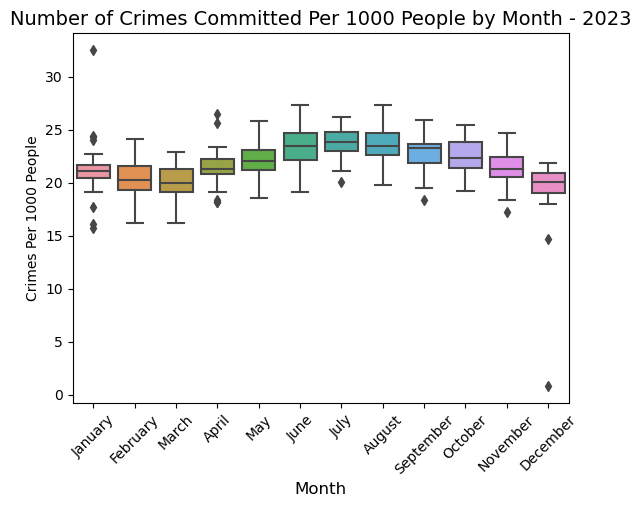

In [119]:
ax = sns.boxplot(x=df_crime_by_month.month, y=df_crime_by_month.crimes_per_thousand_people)

#Setting figure title
plt.title('Number of Crimes Committed Per 1000 People by Month - 2023', size= 14)

#Setting x and y label
plt.xlabel('Month', size = 12)
plt.ylabel('Crimes Per 1000 People', size = 10)

plt.setp(ax.get_xticklabels(), rotation=45)

plt.show();

#### Type of Crime

In [120]:
# df_test = df.copy()

# df_bar = df_test.groupby(['primary_type'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'primary_type', y = 'id', barmode = 'group',
#              title = 'Counts for Type of Crime', 
#              labels = {'id': 'Counts', 'primary_type': 'Type of Crime'})

# fig.update_xaxes(categoryorder = "total descending")

# fig.update_layout(height = 600)

In [121]:
# df_bar = df.groupby(['primary_type','district'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'primary_type', y = 'id', color = 'district', barmode = 'group',
#              title = 'Counts for Type of Crime Based on District', 
#              labels = {'id': 'Counts', 'primary_type': 'Types of Crime', 'district': 'District'})
# fig.update_layout(height = 600)

In [122]:
# df_bar = df.groupby(['primary_type','community_area'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'primary_type', y = 'id', color = 'community_area', barmode = 'group',
#              title = 'Counts for Type of Crime Based on Communtiy Area', 
#              labels = {'id': 'Counts', 'primary_type': 'Types of Crime', 'community_area': 'Community Area'})
# fig.update_layout(height = 600)

In [123]:
# df_bar = df.groupby(['primary_type','regional_community'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'primary_type', y = 'id', color = 'regional_community', barmode = 'group',
#              title = 'Counts for Type of Crime Based on Community Region', 
#              labels = {'id': 'Counts', 'primary_type': 'Types of Crime', 'regional_community': 'Community Region'})
# fig.update_layout(height = 600)

In [124]:
# df_bar = df.groupby(['primary_type','district'])['id'].count().reset_index()

# for i in range(1, 32):
#     print("District", i)
#     df_district = df_bar[df_bar.district == i]

#     fig = px.bar(df_district, x = 'primary_type', y = 'id', barmode = 'group',
#          title = 'Counts for Type of Crime', 
#          labels = {'id': 'Counts', 'primary_type': 'Types of Crime', 'district': 'District'})
#     fig.update_layout(height = 600)
#     fig.show()

In [125]:
# df_bar = df.groupby(['primary_type','community_area'])['id'].count().reset_index()

# for i in range(1, 78):
#     print("Community Area", i)
#     df_comm_area = df_bar[df_bar.community_area == i]

#     fig = px.bar(df_comm_area, x = 'primary_type', y = 'id', barmode = 'group',
#          title = 'Counts for Type of Crime', 
#          labels = {'id': 'Counts', 'primary_type': 'Types of Crime', 'community_area': 'Community Area'})
#     fig.update_layout(height = 600)
#     fig.show()

In [126]:
# crimes_count_date = df.pivot_table('id', aggfunc=np.size, columns='primary_type', index=df.date, fill_value=0)
# crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
# plo = crimes_count_date.plot(figsize=(12, 30), subplots=True, layout=(-1, 3), sharex=False, sharey=False)

In [127]:
# crimes_count_dow = df.pivot_table('id', aggfunc=np.size, columns='primary_type', index=df.dow, fill_value=0).loc[dayOrder]
# #crimes_count_dow.index = pd.DatetimeIndex(crimes_count_dow.index)
# plo = crimes_count_dow.plot(figsize=(12, 30), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [128]:
# crimes_count_month = df.pivot_table('id', aggfunc=np.size, columns='primary_type', index=df.month, fill_value=0).loc[monthOrder]

# plo = crimes_count_month.plot(figsize=(10, 60), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [129]:
# crimes_count = df.pivot_table('id', aggfunc=np.size, columns='primary_type', index=df.district, fill_value=0)

# plo = crimes_count.plot(figsize=(12, 40), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [130]:
# crimes_count = df.pivot_table('id', aggfunc=np.size, columns='primary_type', index=df.regional_community, fill_value=0)

# plo = crimes_count.plot(figsize=(12, 40), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [131]:
# df_line = df.groupby(['primary_type','date'])['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'date', y = 'id', color = 'primary_type',
#         title='Type of Crime Count for 2023 by Date')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Counts')

In [132]:
# df_bar = df.groupby(['dow','primary_type'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.bar(df_bar, x = 'primary_type', y = 'id', color = 'dow',
#         title='Type of Crime Count for 2023 by Day of Week')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Type of Crime', yaxis_title = 'Counts')

In [133]:
# df['month_num'] = df['month_num'].astype(int)

# df_bar = df.groupby(['month_num','primary_type'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.bar(df_bar, x = 'primary_type', y = 'id', color = 'month_num',
#         title='Type of Crime Count for 2023 by Month')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Type of Crime', yaxis_title = 'Counts')

In [134]:
# df_line = df.groupby(['primary_type','month'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'month', y = 'id', color = 'primary_type',
#         title='Type of Crime Count for 2023 by Month')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Counts')

#### Categorized Crime

In [135]:
df_environ_complaint_crime_cat = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype','community_area','crime_category','regional_community']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                         num_of_crimes=('id','count'),
                                                                                                                         population = ('population','mean')).reset_index()

df_environ_complaint_crime_cat['crimes_per_thousand_people'] = 1000*(df_environ_complaint_crime_cat['num_of_crimes']/df_environ_complaint_crime_cat['population'])

df_environ_complaint_crime_cat['environ_complaints_per_thousand_people'] = 1000*(df_environ_complaint_crime_cat['tot_num_environ_complaints']/df_environ_complaint_crime_cat['population'])

df_environ_complaint_crime_cat

,date,month,year,dow,daytype,community_area,crime_category,regional_community,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people,environ_complaints_per_thousand_people
0,2023-01-01,January,2023,Sunday,Weekend,1.0,nonviolent_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
1,2023-01-01,January,2023,Sunday,Weekend,1.0,property_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
2,2023-01-01,January,2023,Sunday,Weekend,1.0,violent_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
3,2023-01-01,January,2023,Sunday,Weekend,2.0,nonviolent_crime,Far North Side,3.0,3,77122.0,0.038899,0.038899
4,2023-01-01,January,2023,Sunday,Weekend,2.0,property_crime,Far North Side,5.0,5,77122.0,0.064832,0.064832
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64616,2023-12-31,December,2023,Sunday,Weekend,49.0,violent_crime,Far Southeast Side,54.0,1,38816.0,0.025763,1.391179
64617,2023-12-31,December,2023,Sunday,Weekend,53.0,property_crime,Far Southeast Side,2.0,1,26104.0,0.038308,0.076617
64618,2023-12-31,December,2023,Sunday,Weekend,67.0,property_crime,Southwest Side,1.0,1,29647.0,0.033730,0.033730
64619,2023-12-31,December,2023,Sunday,Weekend,69.0,nonviolent_crime,South Side,1.0,1,31471.0,0.031775,0.031775


In [136]:
df_line = df_environ_complaint_crime_cat.groupby(['crime_category','date'])['crimes_per_thousand_people'].sum().reset_index()

replacements = {
    'crime_category': {
        'nonviolent_crime':'Nonviolent Crime',
        'violent_crime':'Violent Crime',
        'property_crime':'Property Crime',
    }
}

df_line.replace(replacements, regex=True, inplace=True)

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'date', y = 'crimes_per_thousand_people', color = 'crime_category',
        title='Categorized Crime Per 1000 People by Date - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Counts Per 1000 People', legend_title = 'Crime Category')

In [137]:
# df_bar = df.groupby(['district','crime_category'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'district', y = 'id', color = 'crime_category', barmode = 'group',
#              title = 'Counts for District Based on Categorized Crime - 2023', 
#              labels = {'id': 'Counts', 'crime_category': 'Categorized Crime', 'district': 'District'})
# fig.update_layout(height = 600)

In [138]:
# df_bar = df.groupby(['community_area','crime_category'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'community_area', y = 'id', color = 'crime_category', barmode = 'group',
#              title = 'Counts for Communtiy Area Based on Categorized Crime - 2023', 
#              labels = {'id': 'Counts', 'crime_category': 'Categorized Crime', 'community_area': 'Community Area'})
# fig.update_layout(height = 600)

In [139]:
df_bar = df_environ_complaint_crime_cat.groupby(['crime_category','regional_community'])['crimes_per_thousand_people'].sum().reset_index()

replacements = {
    'crime_category': {
        'nonviolent_crime':'Nonviolent Crime',
        'violent_crime':'Violent Crime',
        'property_crime':'Property Crime',
    }
}

df_bar.replace(replacements, regex=True, inplace=True)

fig = px.bar(df_bar, x = 'crime_category', y = 'crimes_per_thousand_people', color = 'regional_community', barmode = 'group',
             title = 'Categorized Crime Per 1000 People Based on Community Region - 2023', 
             labels = {'crimes_per_thousand_people': 'Crimes Per 1000 People', 'crime_category': 'Categorized Crime', 'regional_community': 'Community Region'})
fig.update_layout(height = 600)

In [140]:
df_bar = df_environ_complaint_crime_cat.groupby(['crime_category','regional_community'])['crimes_per_thousand_people'].sum().reset_index()

replacements = {
    'crime_category': {
        'nonviolent_crime':'Nonviolent Crime',
        'violent_crime':'Violent Crime',
        'property_crime':'Property Crime',
    }
}

df_bar.replace(replacements, regex=True, inplace=True)

fig = px.bar(df_bar, x = 'regional_community', y = 'crimes_per_thousand_people', color = 'crime_category', barmode = 'group',
             title = 'Regional Community Crimes Per 1000 People Based on Categorized Crime - 2023', 
             labels = {'crimes_per_thousand_people': 'Crimes Per 1000 People', 'crime_category': 'Categorized Crime', 'regional_community': 'Community Region'})
fig.update_layout(height = 600)

In [141]:
df_line = df_environ_complaint_crime_cat.groupby(['crime_category','month'], sort=False)['crimes_per_thousand_people'].sum().reset_index()

replacements = {
    'crime_category': {
        'nonviolent_crime':'Nonviolent Crime',
        'violent_crime':'Violent Crime',
        'property_crime':'Property Crime',
    }
}

df_line.replace(replacements, regex=True, inplace=True)

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'month', y = 'crimes_per_thousand_people', color = 'crime_category',
        title='Categorized Crime Per 1000 People by Month - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Counts Per 1000 People', legend_title = 'Crime Category')

##### Number of Crimes Committed Per 1000 People in Chicago by Regional Community for Each Categorized Crime

In [142]:
df_test = df_environ_complaint_crime_cat.groupby(['crime_category','regional_community'])['crimes_per_thousand_people'].sum().reset_index()
df_test.to_csv(output + '\df_test.csv')
df_test

,crime_category,regional_community,crimes_per_thousand_people
0,nonviolent_crime,Central,46.684813
1,nonviolent_crime,Far North Side,92.804587
2,nonviolent_crime,Far Southeast Side,252.752277
3,nonviolent_crime,Far Southwest Side,73.710441
4,nonviolent_crime,North Side,23.882406
5,nonviolent_crime,Northwest Side,47.558577
6,nonviolent_crime,South Side,239.135667
7,nonviolent_crime,Southwest Side,165.392186
8,nonviolent_crime,West Side,236.104019
9,property_crime,Central,215.012722


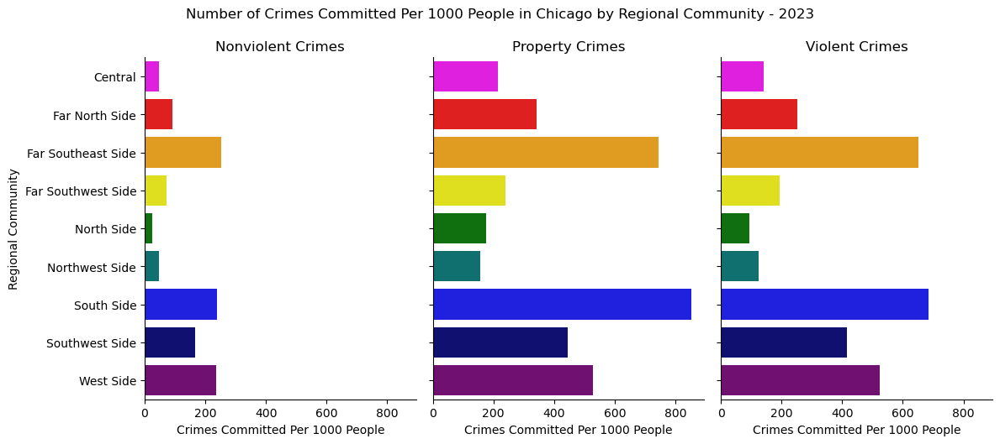

In [143]:
g = sns.FacetGrid(data=df_test, col='crime_category', sharex=True, sharey=True,height=5, aspect=.8)
g.map_dataframe(sns.barplot, x='crimes_per_thousand_people', y='regional_community', hue='regional_community', palette=["magenta", "red", "orange", "yellow", "green", "teal", "blue", "navy", "purple", "grey", "black"], dodge=False)

g.axes[0,0].set_xlabel('Crimes Committed Per 1000 People')
g.axes[0,0].set_title('Nonviolent Crimes')

g.axes[0,1].set_xlabel('Crimes Committed Per 1000 People')
g.axes[0,1].set_title('Property Crimes')

g.axes[0,2].set_xlabel('Crimes Committed Per 1000 People')
g.axes[0,2].set_title('Violent Crimes')

g.set(ylabel = "Regional Community")

g.fig.suptitle('Number of Crimes Committed Per 1000 People in Chicago by Regional Community - 2023', y = 1.05)

plt.show()

##### Number of Crimes Committed Per 1000 People in Chicago by Month for Each Categorized Crime

In [144]:
df_categorized_crime_by_month = df_environ_complaint_crime_cat.groupby(['date','month','year','crime_category'], sort=False)['crimes_per_thousand_people'].sum().reset_index()
df_categorized_crime_by_month

,date,month,year,crime_category,crimes_per_thousand_people
0,2023-01-01,January,2023,nonviolent_crime,5.322139
1,2023-01-01,January,2023,property_crime,12.597763
2,2023-01-01,January,2023,violent_crime,14.606638
3,2023-01-02,January,2023,property_crime,10.683349
4,2023-01-02,January,2023,violent_crime,7.362870
...,...,...,...,...,...
1090,2023-12-30,December,2023,property_crime,10.527452
1091,2023-12-30,December,2023,violent_crime,7.292170
1092,2023-12-31,December,2023,property_crime,0.425789
1093,2023-12-31,December,2023,violent_crime,0.373997


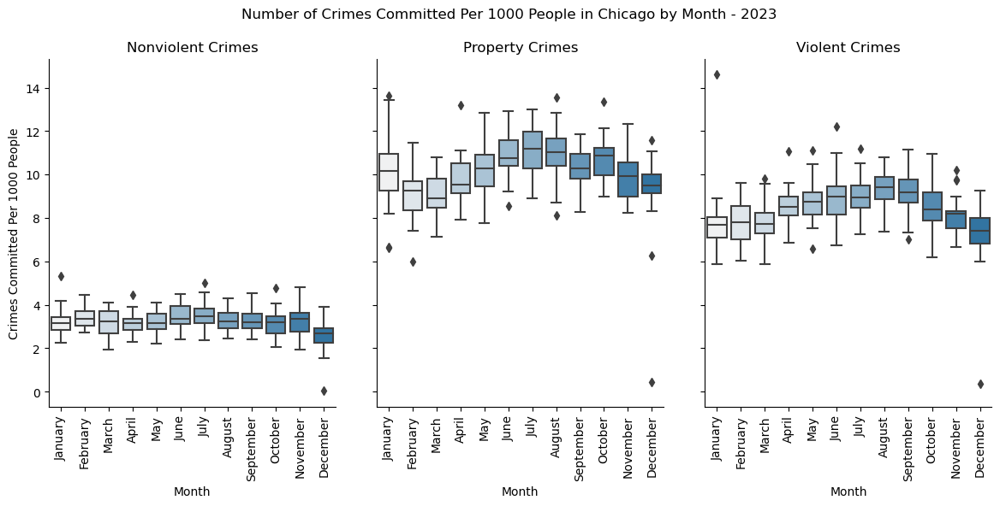

In [145]:
g = sns.FacetGrid(data=df_categorized_crime_by_month, col='crime_category', sharex=True, sharey=True,height=5, aspect=.8)
g.map_dataframe(sns.boxplot, x='month', y='crimes_per_thousand_people', hue='month', dodge=False)

for axes in g.axes.flat:
    _ = axes.set_xticklabels(axes.get_xticklabels(), rotation=90)
    
g.axes[0,0].set_xlabel('Month')
g.axes[0,0].set_title('Nonviolent Crimes')

g.axes[0,1].set_xlabel('Month')
g.axes[0,1].set_title('Property Crimes')

g.axes[0,2].set_xlabel('Month')
g.axes[0,2].set_title('Violent Crimes')

g.set(ylabel = "Crimes Committed Per 1000 People")

g.fig.suptitle('Number of Crimes Committed Per 1000 People in Chicago by Month - 2023', y = 1.05)

plt.show()

#### District

In [146]:
# crimes_count_date = df.pivot_table('id', aggfunc=np.size, columns='district', index=df.date, fill_value=0)
# crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
# plo = crimes_count_date.plot(figsize=(12, 30), subplots=True, layout=(-1, 3), sharex=False, sharey=False)

In [147]:
# crimes_count_dow = df.pivot_table('id', aggfunc=np.size, columns='district', index=df.dow, fill_value=0).loc[dayOrder]

# plo = crimes_count_dow.plot(figsize=(12, 50), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [148]:
# crimes_count_month = df.pivot_table('id', aggfunc=np.size, columns='district', index=df.month, fill_value=0).loc[monthOrder]

# plo = crimes_count_month.plot(figsize=(12, 50), subplots=True, layout=(-1, 3), sharex=False, sharey=False, kind='bar')

In [149]:
# df_test = df.copy()

# df_test['district'] = df_test['district'].astype(str)

# df_bar = df_test.groupby(['district'])['id'].count().reset_index()

# fig = px.bar(df_bar, x = 'district', y = 'id', barmode = 'group',
#              title = 'Counts for Type of Crime Based on Each District', 
#              labels = {'id': 'Counts', 'district': 'District'})

# fig.update_xaxes(categoryorder = "total descending")

# fig.update_layout(height = 600)

In [150]:
# df_line = df.groupby(['district','date'])['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'date', y = 'id', color = 'district',
#         title='District Count for 2023 by Date')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Counts')

In [151]:
# df_line = df.groupby(['district','dow'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'dow', y = 'id', color = 'district',
#         title='District Count for 2023 by Day of Week')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'DOW', yaxis_title = 'Counts')

In [152]:
# df_line = df.groupby(['district','dow'])['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.bar(df_line, x = 'dow', y = 'id', color = 'district',
#         title='District Count for 2023')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'DOW', yaxis_title = 'Counts')

In [153]:
# df_line = df.groupby(['district','month'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.line(df_line, x = 'month', y = 'id', color = 'district',
#         title='District Count for 2023 by Month')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Counts')

In [154]:
# df['month_num'] = df['month_num'].astype(int)

# df_bar = df.groupby(['month_num','district'], sort=False)['id'].count().reset_index()

# # Create the line plot using plotly version of plot
# fig = px.bar(df_bar, x = 'district', y = 'id', color = 'month_num',
#         title='Counts for District for 2023 by Month')  

# # Add the layout with the x- and y-aixs labels 
# fig.update_layout(height = 600, xaxis_title = 'District', yaxis_title = 'Counts')

#### Community Regions

In [155]:
df_environ_complaint_crime_cat

,date,month,year,dow,daytype,community_area,crime_category,regional_community,tot_num_environ_complaints,num_of_crimes,population,crimes_per_thousand_people,environ_complaints_per_thousand_people
0,2023-01-01,January,2023,Sunday,Weekend,1.0,nonviolent_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
1,2023-01-01,January,2023,Sunday,Weekend,1.0,property_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
2,2023-01-01,January,2023,Sunday,Weekend,1.0,violent_crime,Far North Side,0.0,1,55628.0,0.017977,0.000000
3,2023-01-01,January,2023,Sunday,Weekend,2.0,nonviolent_crime,Far North Side,3.0,3,77122.0,0.038899,0.038899
4,2023-01-01,January,2023,Sunday,Weekend,2.0,property_crime,Far North Side,5.0,5,77122.0,0.064832,0.064832
...,...,...,...,...,...,...,...,...,...,...,...,...,...
64616,2023-12-31,December,2023,Sunday,Weekend,49.0,violent_crime,Far Southeast Side,54.0,1,38816.0,0.025763,1.391179
64617,2023-12-31,December,2023,Sunday,Weekend,53.0,property_crime,Far Southeast Side,2.0,1,26104.0,0.038308,0.076617
64618,2023-12-31,December,2023,Sunday,Weekend,67.0,property_crime,Southwest Side,1.0,1,29647.0,0.033730,0.033730
64619,2023-12-31,December,2023,Sunday,Weekend,69.0,nonviolent_crime,South Side,1.0,1,31471.0,0.031775,0.031775


In [156]:
df_bar = df_environ_complaint_crime_cat.groupby(['regional_community'])['crimes_per_thousand_people'].sum().reset_index()

fig = px.bar(df_bar, x = 'regional_community', y = 'crimes_per_thousand_people', barmode = 'group',
             title = 'Counts for Type of Crime Based on Each Regional Community - 2023', 
             labels = {'crimes_per_thousand_people': 'Crimes Per 1000 People', 'regional_community': 'Regional Community'})

fig.update_xaxes(categoryorder = "total descending")

fig.update_layout(height = 600)

In [157]:
df_line = df_environ_complaint_crime_cat.groupby(['regional_community','date'])['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'date', y = 'crimes_per_thousand_people', color = 'regional_community',
        title='Number of Crimes Committed Per 1000 People in Each Regional Community by Date - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Date', yaxis_title = 'Counts Per 1000 People', legend_title = 'Regional Community')

In [158]:
df_line = df_environ_complaint_crime_cat.groupby(['regional_community','dow'], sort=False)['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'dow', y = 'crimes_per_thousand_people', color = 'regional_community',
        title='Number of Crimes Committed Per 1000 People in Each Regional Community by Day of Week - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Day of Week', yaxis_title = 'Counts Per 1000 People', legend_title = 'Regional Community')

In [159]:
df_line = df_environ_complaint_crime_cat.groupby(['regional_community','month'], sort=False)['crimes_per_thousand_people'].sum().reset_index()

# Create the line plot using plotly version of plot
fig = px.line(df_line, x = 'month', y = 'crimes_per_thousand_people', color = 'regional_community',
        title='Number of Crimes Committed Per 1000 People in Each Regional Community by Month - 2023')  

# Add the layout with the x- and y-aixs labels 
fig.update_layout(height = 600, xaxis_title = 'Month', yaxis_title = 'Counts Per 1000 People', legend_title = 'Regional Community')

#### Correlation Heatmap for All Numerical Variables

In [160]:
df_environmental_complaint.describe()

,id,beat,district,ward,community_area,latitude,longitude,location.latitude,location.longitude,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station_distance,population,area(sq mi.),density (/sq mi.),clean and green program request,lead inspection request,sewer cave-in inspection request,sewer cleaning inspection request,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),water lead test kit request,water lead test visit request,water quality concern,extreme weather notification,ice and snow removal request,low water pressure complaint,tot_num_environ_complaints
count,2.593030e+05,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.000000,259303.0,259303.000000,259303.000000,259303.000000
mean,1.310302e+07,1155.579689,11.326437,23.123331,36.286240,41.794302,-87.672965,41.794302,-87.672965,38.318369,169.759147,2.696090,0.962758,63.830855,47.461500,55.568058,370.718068,48863.619252,3.388296,15735.384648,0.016409,0.016814,0.228547,0.495613,0.026375,0.001323,0.054072,1.036868,0.602723,0.955986,0.793377,1.973768,0.408464,0.086860,0.033201,0.0,0.032865,0.100597,6.863862
std,6.517233e+05,712.332518,7.119359,14.013948,21.572781,2.710961,0.225957,2.710961,0.225957,32.814667,137.580479,8.759992,5.409081,18.615354,16.338469,17.122571,19237.632600,26877.495514,1.761622,8228.666499,0.141736,0.131980,0.567272,1.287319,0.213076,0.042417,0.806978,1.807689,1.694127,6.724868,1.333591,6.397212,0.864418,0.640508,0.208839,0.0,0.346085,0.372361,11.068925
min,2.727900e+04,111.000000,1.000000,-99.000000,1.000000,-99.000000,-99.000000,-99.000000,-99.000000,0.000000,7.000000,0.000000,0.000000,12.020000,1.040000,7.520000,0.000932,2527.000000,0.580000,1005.850000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
25%,1.303810e+07,533.000000,5.000000,10.000000,22.000000,41.770674,-87.710320,41.770674,-87.710320,13.000000,80.000000,0.000000,0.000000,48.020000,33.980000,41.000000,0.190367,27300.000000,2.120000,9597.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,1.000000
50%,1.313518e+07,1032.000000,10.000000,23.000000,32.000000,41.863440,-87.662258,41.863440,-87.662258,21.000000,102.000000,0.000000,0.000000,66.920000,46.940000,55.400000,0.334521,42298.000000,3.150000,13619.530000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,3.000000
75%,1.323047e+07,1732.000000,17.000000,34.000000,53.000000,41.909932,-87.626840,41.909932,-87.626840,59.000000,245.000000,1.000000,0.000000,80.960000,62.960000,71.420000,0.554729,67881.000000,3.770000,19166.160000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.0,0.000000,0.000000,8.000000
max,1.333522e+07,2535.000000,31.000000,50.000000,77.000000,42.022549,-87.524532,42.022549,-87.524532,127.000000,567.000000,101.900000,51.000000,100.040000,75.920000,89.240000,999999.000000,105481.000000,13.340000,38496.720000,3.000000,2.000000,8.000000,36.000000,6.000000,4.000000,35.000000,25.000000,64.000000,193.000000,65.000000,79.000000,35.000000,74.000000,8.00

In [161]:
columns = ['beat',
'district',
'ward',
'community_area',
'latitude',
'longitude',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station_distance',
'population',
'area(sq mi.)',
'density (/sq mi.)',
'clean and green program request',
'lead inspection request',
'sewer cave-in inspection request',
'sewer cleaning inspection request',
'snow - object/dibs removal request',
'snow removal - protected bike lane or bridge sidewalk',
'snow – uncleared sidewalk complaint',
'tree debris clean-up request',
'tree emergency',
'tree planting request',
'tree removal request',
'tree trim request (no longer being accepted)',
'water lead test kit request',
'water lead test visit request',
'water quality concern',
#'extreme weather notification',
'ice and snow removal request',
'low water pressure complaint',
'tot_num_environ_complaints']

# Create the correlation matrix for the correlation
df_corr = df_environmental_complaint[columns]

# Run the correlation matrix 
df_corr.corr()

,beat,district,ward,community_area,latitude,longitude,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station_distance,population,area(sq mi.),density (/sq mi.),clean and green program request,lead inspection request,sewer cave-in inspection request,sewer cleaning inspection request,snow - object/dibs removal request,snow removal - protected bike lane or bridge sidewalk,snow – uncleared sidewalk complaint,tree debris clean-up request,tree emergency,tree planting request,tree removal request,tree trim request (no longer being accepted),water lead test kit request,water lead test visit request,water quality concern,ice and snow removal request,low water pressure complaint,tot_num_environ_complaints
beat,1.000000,0.999819,0.667371,-0.484329,0.022023,-0.141862,-0.190607,0.248065,0.001824,-0.003442,-0.001847,-0.000812,-0.001594,-0.001321,0.510347,0.138223,0.415778,0.008408,-0.007861,0.082554,0.067195,0.028597,0.008003,0.051155,0.025485,0.060781,0.000137,0.123606,0.083126,0.143500,0.008880,0.007973,0.015830,0.080681,0.107932
district,0.999819,1.000000,0.668185,-0.484600,0.022096,-0.142147,-0.190936,0.246884,0.001818,-0.003455,-0.001833,-0.000801,-0.001578,-0.001359,0.509380,0.136423,0.415561,0.008309,-0.007906,0.082451,0.067129,0.028421,0.007995,0.051116,0.025525,0.060892,0.000264,0.123694,0.083177,0.143622,0.008799,0.007916,0.015796,0.080676,0.108054
ward,0.667371,0.668185,1.000000,-0.544262,0.025218,-0.125528,-0.270555,0.277964,0.003058,-0.000072,-0.001402,-0.000576,-0.001030,-0.001769,0.413236,0.084501,0.433766,0.001354,-0.018826,0.064588,0.021214,0.010609,0.006285,0.048799,-0.038242,0.020152,0.002192,0.058876,0.065492,0.117135,-0.008100,0.006285,0.009029,0.041199,0.062937
community_area,-0.484329,-0.484600,-0.544262,1.000000,-0.026442,0.055036,0.412993,-0.453267,0.000791,0.008316,-0.006443,-0.008150,-0.007440,0.001961,-0.542311,0.086631,-0.575592,-0.000532,0.016026,-0.066238,-0.029273,0.005153,-0.022354,-0.060035,0.086439,-0.003691,0.010179,-0.007747,-0.081869,-0.123407,0.032798,-0.016436,-0.012852,-0.023806,-0.048744
latitude,0.022023,0.022096,0.025218,-0.026442,1.000000,0.959748,-0.010845,0.012212,0.000111,0.002238,0.011788,0.009179,0.010578,-0.999482,0.019165,-0.001140,0.021694,0.002126,0.000484,0.003801,0.000505,-0.000249,0.001227,0.003160,-0.000077,0.002816,-0.000009,0.006110,0.002499,0.009283,-0.001498,-0.001554,0.002160,0.003324,0.003898
longitude,-0.141862,-0.142147,-0.125528,0.055036,0.959748,1.000000,0.018025,0.016089,-0.000827,0.003108,0.012144,0.009711,0.011116,-0.964729,-0.057483,-0.089890,0.014143,-0.001107,0.002222,-0.017542,-0.019195,-0.020412,0.000863,-0.000143,-0.003816,-0.007691,-0.010823,-0.026233,-0.013057,-0.016389,-0.005358,-0.001233,-0.003789,-0.031420,-0.025391
total_offenders_in_ca,-0.190607,-0.190936,-0.270555,0.412993,-0.010845,0.018025,1.000000,-0.291803,0.000652,0.001495,-0.009146,-0.010133,-0.010273,-0.002823,-0.069523,0.222540,-0.345988,0.038427,0.052943,0.022509,0.106731,0.051251,-0.016915,-0.032910,0.261745,0.113300,0.045434,0.144897,-0.026982,0.010160,0.078109,0.018984,0.015586,0.102793,0.112382
total_complaints_in_ca,0.248065,0.246884,0.277964,-0.453267,0.012212,0.016089,-0.291803,1.000000,-0.001107,-0.002867,0.008185,0.009592,0.009361,0.000473,0.682917,0.181459,0.564998,0.013886,-0.007399,0.085572,0.020190,-0.009182,0.038586,0.064167,-0.075295,0.008874,-0.019800,0.033256,0.164264,0.149920,-0.009621,0.025082,0.021807,0.004212,0.099895
prcp,0.001824,0.001818,0.003058,0.000791,0.000111,-0.000827,0.000652,-0.001107,1.000000,-0.016152,0.063330,0.131145,0.087667,-0.000060,-0.000503,-0.000172,0.001090,-0.016185,-0.012154,0.007868,0.235844,-0.011849,-0.007298,-0.018847,0.051799,0.157077,0.000686,0.067904,-0.012029,0.010682,0.011905,0.004487,-0.016465,0.003574,0.061210
snow,-0.003442,-0.003455,-0.000072,0.008316,0.002238,0.003108,0.001495,-0.002867,-0.016152,1.000000,-0.320157,-0.344415,-0.331777,-0.002499,-0.003242,0.000767,-0.003922,-0.017337,-0.017004,-0

Text(0.5, 1.0, 'Heatmap - All Environmental Complaints')

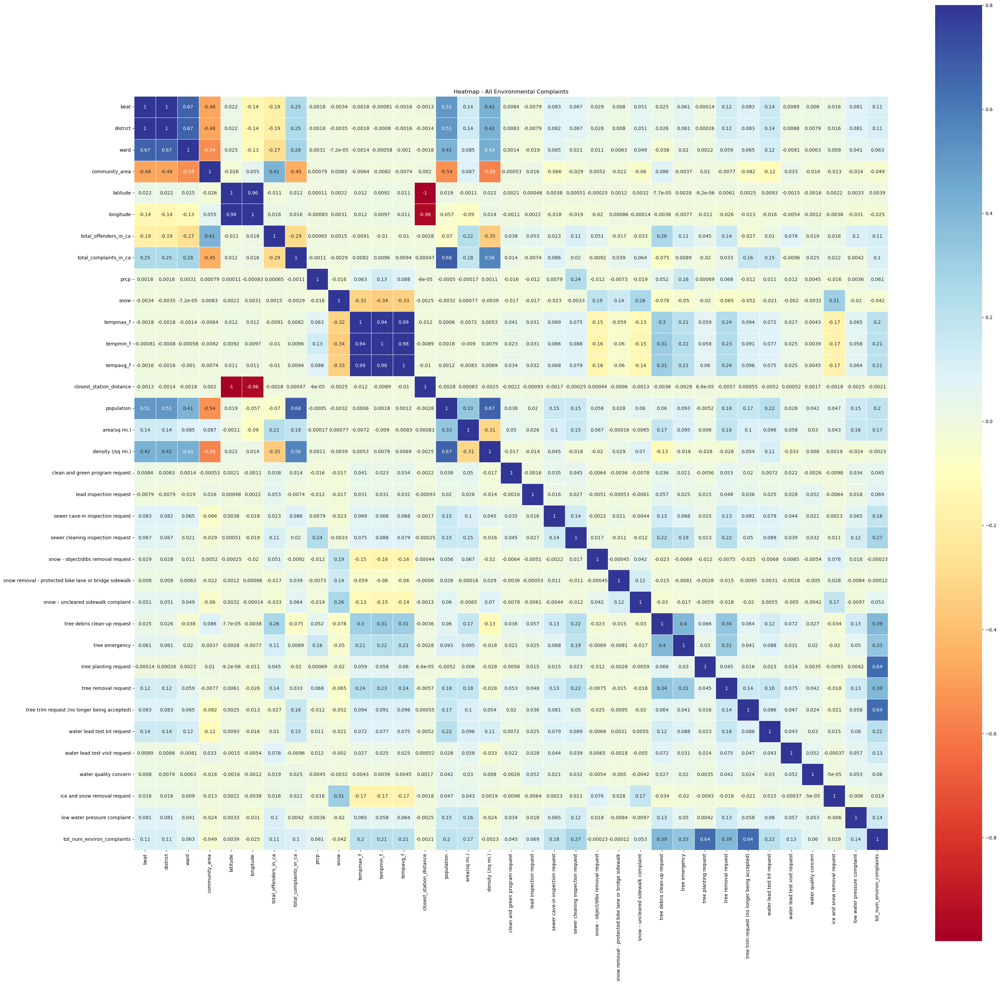

In [162]:
# Set up the heatmap 
corrmat = df_corr.corr()

# Set up the figure size
f, ax = plt.subplots(figsize=(36,36))

# Create the heatmap and create the parameters
sns.heatmap(corrmat, vmax=.8, square=True, annot=True, cmap='RdYlBu', linewidths=.5 )
plt.title('Heatmap - All Environmental Complaints')

In [181]:
columns = ['beat',
'district',
'ward',
'community_area',
'latitude',
'longitude',
'total_offenders_in_ca',
'total_complaints_in_ca',
'prcp',
'snow',
'tempmax_f',
'tempmin_f',
'tempavg_f',
'closest_station_distance',
#'population',
#'area(sq mi.)',
'density (/sq mi.)',
# 'clean and green program request',
# 'lead inspection request',
# 'sewer cave-in inspection request',
# 'sewer cleaning inspection request',
# 'snow - object/dibs removal request',
# 'snow removal - protected bike lane or bridge sidewalk',
# 'snow – uncleared sidewalk complaint',
# 'tree debris clean-up request',
# 'tree emergency',
# 'tree planting request',
# 'tree removal request',
# 'tree trim request (no longer being accepted)',
# 'water lead test kit request',
# 'water lead test visit request',
# 'water quality concern',
# #'extreme weather notification',
# 'ice and snow removal request',
# 'low water pressure complaint',
'tot_num_environ_complaints']

# Create the correlation matrix for the correlation
df_corr = df_environmental_complaint[columns]

# Run the correlation matrix 
df_corr.corr()

,beat,district,ward,community_area,latitude,longitude,total_offenders_in_ca,total_complaints_in_ca,prcp,snow,tempmax_f,tempmin_f,tempavg_f,closest_station_distance,density (/sq mi.),tot_num_environ_complaints
beat,1.000000,0.999819,0.667371,-0.484329,0.022023,-0.141862,-0.190607,0.248065,0.001824,-0.003442,-0.001847,-0.000812,-0.001594,-0.001321,0.415778,0.107932
district,0.999819,1.000000,0.668185,-0.484600,0.022096,-0.142147,-0.190936,0.246884,0.001818,-0.003455,-0.001833,-0.000801,-0.001578,-0.001359,0.415561,0.108054
ward,0.667371,0.668185,1.000000,-0.544262,0.025218,-0.125528,-0.270555,0.277964,0.003058,-0.000072,-0.001402,-0.000576,-0.001030,-0.001769,0.433766,0.062937
community_area,-0.484329,-0.484600,-0.544262,1.000000,-0.026442,0.055036,0.412993,-0.453267,0.000791,0.008316,-0.006443,-0.008150,-0.007440,0.001961,-0.575592,-0.048744
latitude,0.022023,0.022096,0.025218,-0.026442,1.000000,0.959748,-0.010845,0.012212,0.000111,0.002238,0.011788,0.009179,0.010578,-0.999482,0.021694,0.003898
longitude,-0.141862,-0.142147,-0.125528,0.055036,0.959748,1.000000,0.018025,0.016089,-0.000827,0.003108,0.012144,0.009711,0.011116,-0.964729,0.014143,-0.025391
total_offenders_in_ca,-0.190607,-0.190936,-0.270555,0.412993,-0.010845,0.018025,1.000000,-0.291803,0.000652,0.001495,-0.009146,-0.010133,-0.010273,-0.002823,-0.345988,0.112382
total_complaints_in_ca,0.248065,0.246884,0.277964,-0.453267,0.012212,0.016089,-0.291803,1.000000,-0.001107,-0.002867,0.008185,0.009592,0.009361,0.000473,0.564998,0.099895
prcp,0.001824,0.001818,0.003058,0.000791,0.000111,-0.000827,0.000652,-0.001107,1.000000,-0.016152,0.063330,0.131145,0.087667,-0.000060,0.001090,0.061210
snow,-0.003442,-0.003455,-0.000072,0.008316,0.002238,0.003108,0.001495,-0.002867,-0.016152,1.000000,-0.320157,-0.344415,-0.331777,-0.002499,-0.003922,-0.042391


<Axes: >

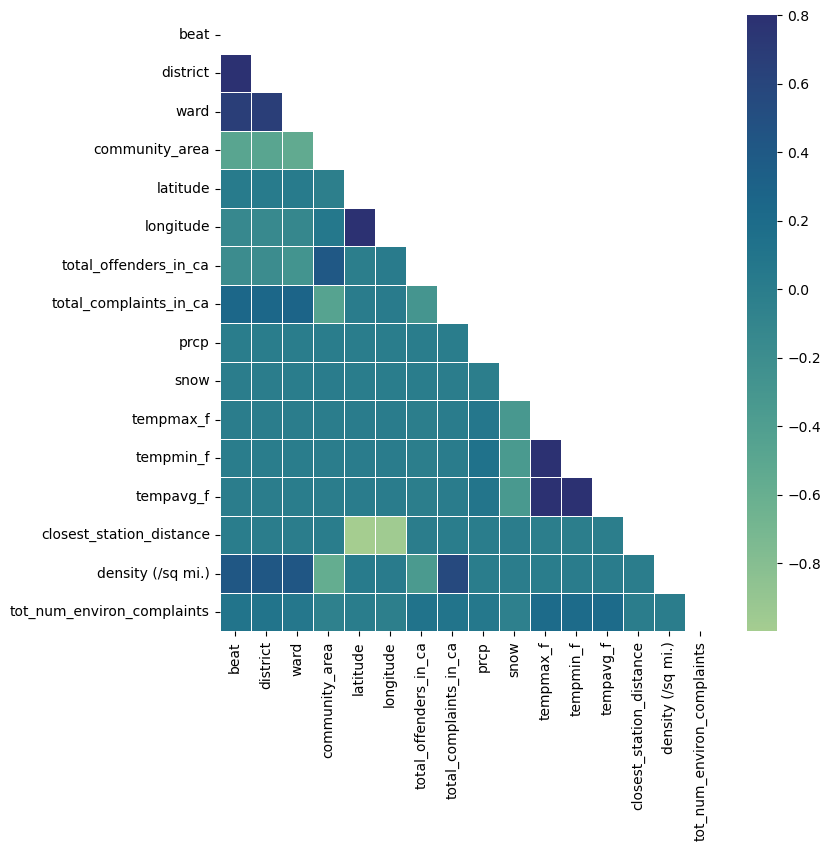

In [191]:
# Set up the heatmap 
corrmat = df_corr.corr()

# Only show lower half of correlation heatmap
matrix = np.triu(corrmat)

# Set up the figure size
f, ax = plt.subplots(figsize=(8,8))

# Create the heatmap and create the parameters
#sns.heatmap(corrmat, vmax=.8, square=True, annot=True, cmap='crest', linewidths=.5 )
sns.heatmap(corrmat, vmax=.8, mask=matrix, annot=False, cmap='crest', linewidths=.5 )
#plt.title('Heatmap')

### Exploratory Data Analysis for Weather

In [165]:
df_weather_by_date = df_environmental_complaint.groupby(['date', 'month', 'year', 'dow', 'daytype','community_area']).agg(tot_num_environ_complaints=('tot_num_environ_complaints','sum'),
                                                                                                                         num_of_crimes=('id','count'),
                                                                                                                         population = ('population','mean'),
                                                                                                                         avg_temp = ('tempavg_f','mean')).reset_index()

df_weather_by_date['crimes_per_thousand_people'] = 1000*(df_weather_by_date['num_of_crimes']/df_weather_by_date['population'])

df_weather_by_date['environ_complaints_per_thousand_people'] = 1000*(df_weather_by_date['tot_num_environ_complaints']/df_weather_by_date['population'])

df_weather_by_date.to_csv(output + '\df_weather_by_date.csv')

df_weather_by_date

,date,month,year,dow,daytype,community_area,tot_num_environ_complaints,num_of_crimes,population,avg_temp,crimes_per_thousand_people,environ_complaints_per_thousand_people
0,2023-01-01,January,2023,Sunday,Weekend,1.0,0.0,3,55628.0,41.72,0.053930,0.000000
1,2023-01-01,January,2023,Sunday,Weekend,2.0,20.0,20,77122.0,41.72,0.259329,0.259329
2,2023-01-01,January,2023,Sunday,Weekend,3.0,12.0,12,57182.0,41.72,0.209856,0.209856
3,2023-01-01,January,2023,Sunday,Weekend,4.0,8.0,8,40494.0,41.72,0.197560,0.197560
4,2023-01-01,January,2023,Sunday,Weekend,5.0,0.0,4,35114.0,41.72,0.113915,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
26958,2023-12-31,December,2023,Sunday,Weekend,49.0,54.0,1,38816.0,34.34,0.025763,1.391179
26959,2023-12-31,December,2023,Sunday,Weekend,53.0,2.0,1,26104.0,34.34,0.038308,0.076617
26960,2023-12-31,December,2023,Sunday,Weekend,67.0,1.0,1,29647.0,34.34,0.033730,0.033730
26961,2023-12-31,December,2023,Sunday,Weekend,69.0,1.0,1,31471.0,34.34,0.031775,0.031775


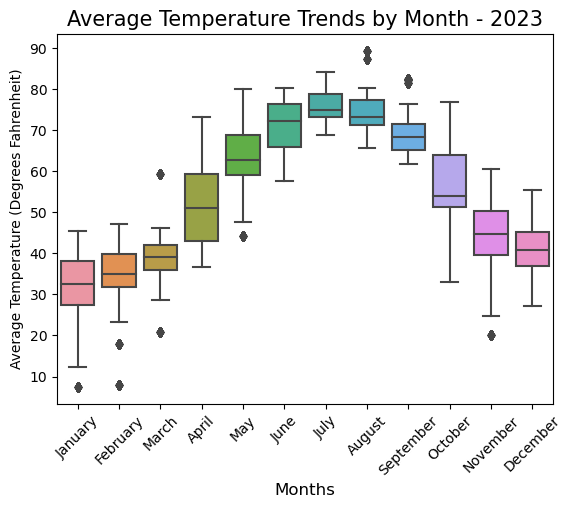

In [166]:
ax = sns.boxplot(x=df_weather_by_date.month, y=df_weather_by_date.avg_temp)

#Setting figure title
plt.title('Average Temperature Trends by Month - 2023', size= 15)

#Setting x and y label
plt.xlabel('Months', size = 12)
plt.ylabel('Average Temperature (Degrees Fahrenheit)', size = 10)

plt.setp(ax.get_xticklabels(), rotation=45)

plt.show();